# Computer Vision - Assignment 3 - Feature Extraction and Image Stitching

#### 10 points   |   Due date: December 31, 23:59   |   Submission site: https://pradogrado2324.ugr.es/

### Student's Full Name: González Durán, David



<font color=#80BEF1>In this assignment you will learn:

<font color=#80BEF1>a) to detect interest points using the Harris Corner Detector (Exercise 2) and a multi-scale approach to detect blobs using the Laplacian of Gaussian (Exercise 1).

<font color=#80BEF1>b) to find correspondences between the keypoints from two images using descriptors (SIFT and Haralick) (Exercise 3).

<font color=#80BEF1>c) to compose a rectangular mosaic/panorama from a bunch of images using homographies (Exercise 4).

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
import sys,os
%cd '/content/drive/My Drive'
get_image = lambda route: os.path.join('/content/drive/MyDrive/images/', route)
import numpy as np
import math
from matplotlib import pyplot as plt
import cv2
! pip install scikit-image
!pip install mahotas

Mounted at /content/drive
/content/drive/My Drive


In [ ]:
'''
This function receives a string with the filename of the image to read,
and a flag indicating if we want to read it in color/RGB (flagColor=1) or gray level (flagColor=0)

Example of use:
im1=readIm(get_image('apple.jpg'),0)

'''
def readIm(filename, flagColor=1):
  # cv2 reads BGR format
  im=cv2.imread(filename)
  # change to  RGB and return the image
  if(flagColor):
    return cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  # change from BGR to grayscale instead if flag is 0
  return cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)

In [ ]:
'''
This function receives an array of arbitrary real numbers (that could include even negative values),
and returns an 'image' in the range [0,1].
flag_GLOBAL allows the user to normalize the whole image (including all channels) or to normalize
each channel/band independently.
'''
def rangeDisplay01(im, flag_GLOBAL= True):
  im = im.astype(float)
  if flag_GLOBAL:
    im = (im - im.min())/(im.max() - im.min())
  else:
    # bands normalization
    for band in range(im.shape[2]):
      im[:, :, band] = (im[:, :, band] - im[:, :, band].min())/(im[:, :, band].max() - im[:, :, band].min())
      # Note: remember that, for plt.imshow with RGB data, the valid range is [0..1] for floats and [0..255] for integers.
  return im

In [ ]:
'''
This function displays a single image, including a title, using a magnification factor.

Example of use:
im1=readIm(get_image('apple.jpg'),0)
displayIm(im1,'Manzana',0.5)

'''
def displayIm(im, title='Result',factor= 2):
  # First normalize range
  max=np.max(im)
  min=np.min(im)
  if min<0 or max>255:
    im=rangeDisplay01(im,flag_GLOBAL=True)
  if len(im.shape) == 3:
    # im es tribanda
    plt.imshow(im, cmap='jet')
  else:
    # im es monobanda
    plt.imshow(im, cmap='gray')
  figure_size = plt.gcf().get_size_inches()
  plt.gcf().set_size_inches(factor * figure_size)
  plt.title(title)
  plt.xticks([]), plt.yticks([]) # eliminamos numeración
  plt.show()

In [ ]:
'''
This function displays multiple images (including a title and using a magnification factor)
of equal size. The input to the function is a list of images.

Example of use:
im1=readIm(get_image('apple.jpg'),1)
images = [im1,im1,im1]

displayMI_ES(images, title='Manzanas',factor=1)

'''
def displayMI_ES(vim, title='Result',factor=2):
  # We set the maximun number of images to concatenate by columns
  maxcolumns=3
  # number of images to display
  numberim=len(vim)
  # The simplest case, one row: the maximum number of columns is larger than the images to stack
  # This is, by default, we put together the images column-wise
  if len(vim) < maxcolumns:
    out=vim[0]
    for item in range(1,len(vim)):
      #displayIm(out,str(item),1)
      out=np.hstack((out,vim[item]))

  # Else, if maxcolumns is smaller or equal than the number of images to stack
  else:
    # We check if all rows and columns are going to be 'busy', or if otherwise we need an extra-row
    if np.mod(len(vim),maxcolumns)== 0:
      maxrows=numberim//maxcolumns
    else:
      maxrows=numberim//maxcolumns+1

    # we build up the first block-row
    out=vim[0]
    for item in range(1,maxcolumns):
      out=np.hstack((out,vim[item]))
    # We build up the rest of block-rows
    for block in range(1,maxrows):
      #print(block)
      row=vim[block*maxcolumns]
      for item in range(1,maxcolumns):
        # We still have images to stack
        if block*maxcolumns+item < numberim:
          row=np.hstack((row,vim[block*maxcolumns+item]))
        # We do not have more images, and we have to fill with black
        else:
          row=np.hstack((row,np.zeros(vim[0].shape,dtype=vim[0].dtype)))
          #print(row.dtype)
          # if we don't include ',dtype=vim[0].dtype', np.zeros will include float
          # numbers in the matrix. This will make that the whole matrix will be
          # considered as floats, and values larger than 1 will be clipped to 1,
          # displaying an almost totally white image
      # add the new block-row
      out=np.vstack((out,row))
  return displayIm(out,title,factor)

In [ ]:
# Here you include your functions from P1 to compute derivatives and convolution

def GaussFunc(x,sigma):
    return np.exp(-(x**2)/(2*sigma**2))

def GaussDeriv1Func(x,sigma):
    return np.exp(-(x**2)/(2*sigma**2)) * (-x/(sigma**2))

def GaussDeriv2Func(x,sigma):
    return np.exp(-(x**2)/(2*sigma**2)) * (-((x**2-sigma**2)/(sigma**4)))


def gaussianMask1D(sigma, order=0):

    sizeMask = math.ceil(6 * sigma)

    if sizeMask % 2 == 0:
        sizeMask += 1

    first_value = -math.floor(sizeMask / 2)
    xvalues = np.arange(first_value, first_value + sizeMask)

    # Calcular la máscara gaussiana en función del orden
    if order == 0:
        mask = GaussFunc(xvalues, sigma)
        mask /= sum(mask)
    elif order == 1:
        mask = GaussDeriv1Func(xvalues, sigma)
    elif order == 2:
        mask = GaussDeriv2Func(xvalues, sigma)
    else:
        raise ValueError("El 'order' debe ser 0, 1 o 2 para la derivada de orden.")

    return mask, xvalues


def my2DConv(im, sigma, order):

    ddepth=cv2.CV_64F
    maskG,_ = gaussianMask1D(sigma, order=0)
    maskDG,_ = gaussianMask1D(sigma, order=1)
    mask2DG,_ = gaussianMask1D(sigma, order=2)

    if order==[0,0]: # Suavizado Gaussiano
        return cv2.sepFilter2D(im, ddepth, maskG, maskG)
    elif order==[1,0]: # Primera derivada en x
        return cv2.sepFilter2D(im, ddepth, maskDG, maskG)
    elif order==[0,1]: # Primera derivada en y
        return cv2.sepFilter2D(im, ddepth, maskG, maskDG)
    elif order==[2,0]: # Segunda derivada en x
        return cv2.sepFilter2D(im, ddepth, mask2DG, maskG)
    elif order==[0,2]: # Segunda derivada en y
        return cv2.sepFilter2D(im, ddepth, maskG, mask2DG)
    else:
        print('error in order of derivative')


def LoG(im, sigma):
    return (my2DConv(im,sigma,[0,2]) + my2DConv(im,sigma,[2,0])) * (sigma **2)

# <font color=#80BEF1>**Exercise 1:** Multi-scale blob detection using the Laplacian of Gaussian (2 points)

<font color=#80BEF1> Students must implement a multiscale blob detector in Python that, based on successive applications of Laplacian of Gaussian (LoG) filters, allows them to identify interest points/regions. The process to follow is detailed below:

> <font color=#80BEF1>1) use the following sigmas to create the corresponding scales: 11 values starting from $\sigma_0 = 0.5$ and increase $\sigma$ by a factor of 1.5. In other words, $\sigma=[0.5, 0.75, 1.125, 1.687, 2.531, 3.796, 5.695, 8.542, 12.814, 19.221, 28.832]$. Remember to convolve the image with scale-normalized LoG (Laplacian of Gaussian).

> <font color=#80BEF1>2) Find maxima of squared Laplacian response in scale-space. Select the local maximum corresponding to a neighborhood $3\times3\times3$, where the central pixel of this volume would be the position to evaluate. That is, each pixel is compared with its 26 neighbors and saved if it is a maximum. The function `maximum_filter` from `scipy.ndimage` may be useful here. Along with this, also use a $\textit{threshold}$ to limit the number of blobs detected to around 1000 points.

> <font color=#80BEF1>3) Draw the detected blobs as circles centered on the identified Cartesian coordinates, and radius proportional to the scale at which the corresponding blob was detected.

<font color=#80BEF1>The process is visually shown on slide 63 of https://pradogrado2324.ugr.es/pluginfile.php/234073/mod_folder/content/0/3.3.BoW_Blobs.pdf

El filtro laplaciano, tal y como vimos en el tema 1, es bueno detectando regiones de cambio abrupto en la intensidad en todas las direcciones de una imagen.


El **detector multiescala de *blobs* basado en la Laplaciana de la Gaussiana** (LoG, *Laplacian of Gaussian*) se aprovecha de la capacidad de esta operación para detectar la presencia de características distintas en una imagen.

Para esto, busca la respuesta máxima —si bien nosotros también consideraremos mínima— de una región de la imagen antes distintos filtros laplacianos, de menor y mayor tamaño (diferentes valores de sigma). Justo en estas áreas donde se alcanza un óptimo, para un radio equivalente a $\sigma\sqrt{2}$ (para el cual el filtro laplaciano alcanza la máxima respuesta) existe una diferencia pronunciada de de intensidades, lo que indica que puede existir una característica distintiva. Este proceso de aplicación permitee identificar la presencia de estas características en múltiples escalas.  

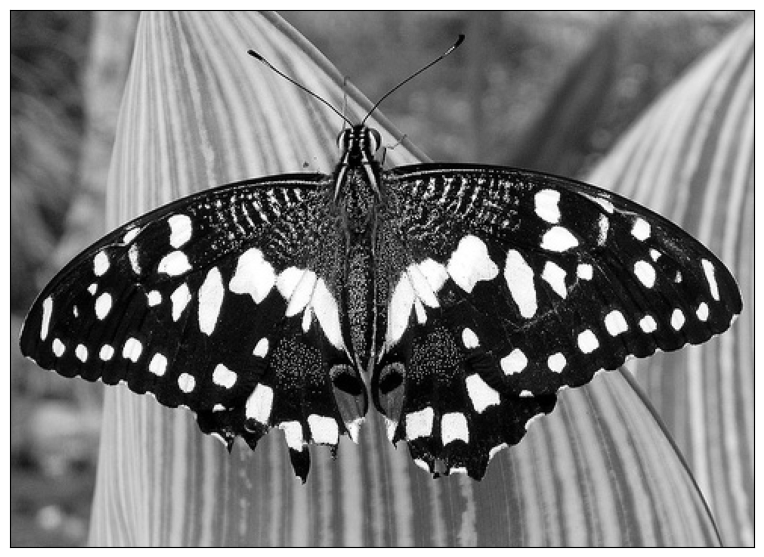

In [ ]:
# Carga de imagen y conversión a escala de grises
img = readIm(get_image('butterfly.jpg'),0)

# Convierte los datos de la imagen a tipo float32
img = np.float32(img)

# Normaliza los valores entre 0 y 1
img /= img.max()

# Obtiene el número de filas y columnas
num_filas = np.shape(img)[0]
num_columnas = np.shape(img)[1]

# Muestra la imagen
displayIm(img,"",1.5)

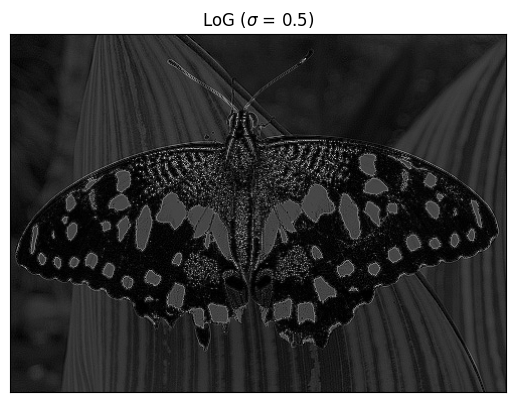

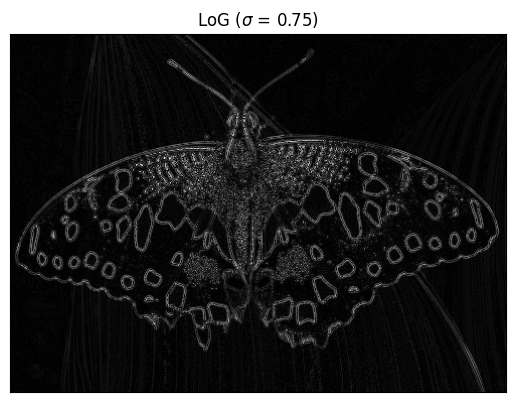

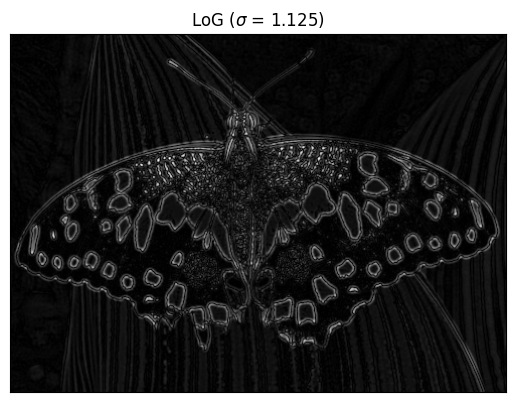

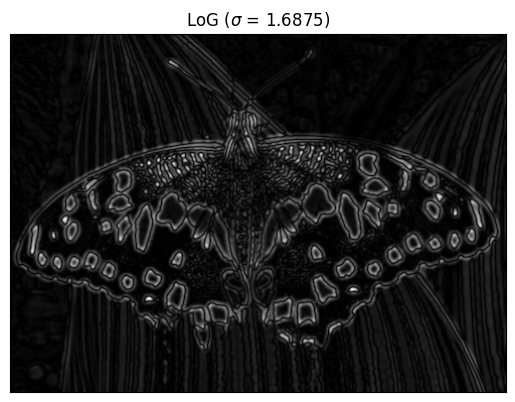

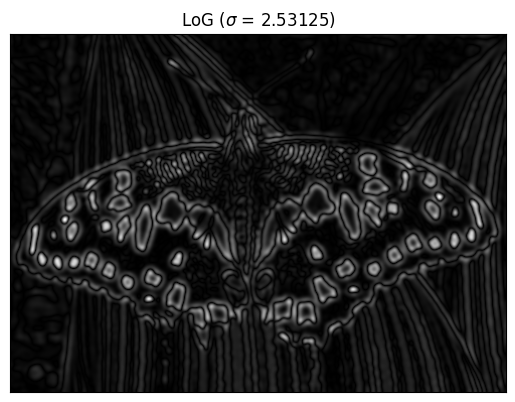

...

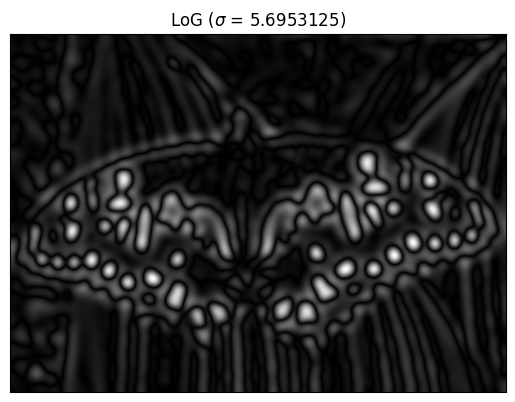

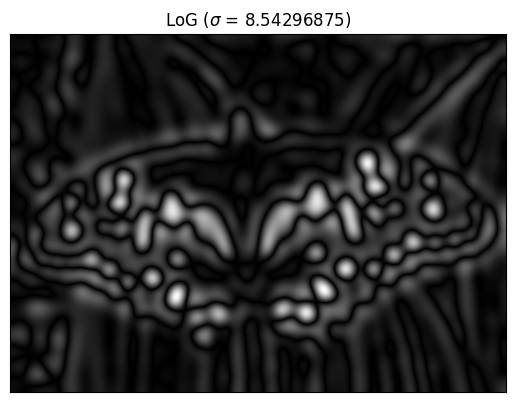

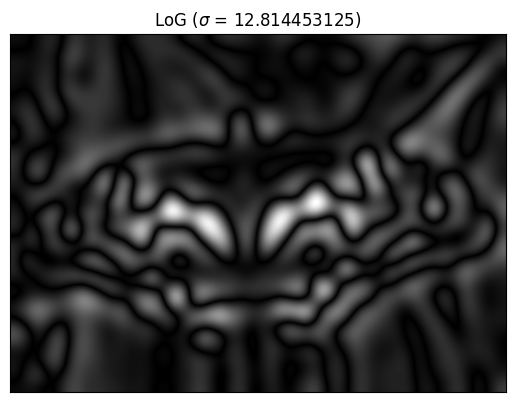

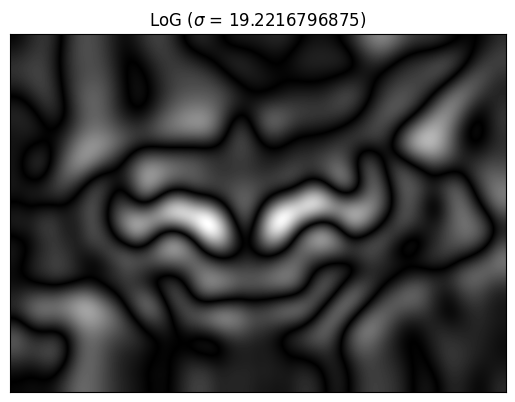

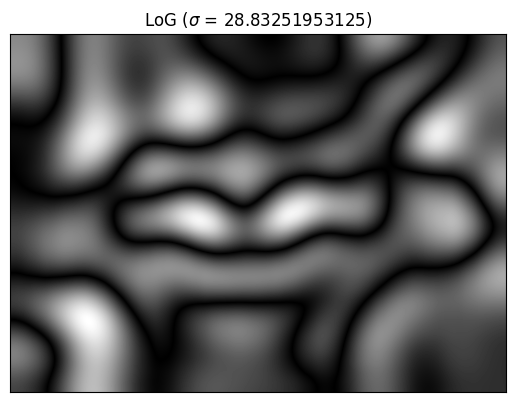

In [ ]:
# Definición de una lista de valores sigma para el filtro Laplaciano de la gaussiana (LoG)
sigma_list = np.array([0.5 * (1.5 ** i) for i in range(11)])

# Cálculo de la respuesta LoG correspondientes a cada valor de sigma
log_response = np.empty((len(sigma_list), img.shape[0], img.shape[1]), dtype=np.float32)
for i,s in enumerate(sigma_list):
    log_response[i,...] = np.abs(LoG(img,s))
    displayIm(log_response[i,...], f"LoG ($\sigma$ = {s})", 1)

En estas imágenes podemos apreciar cómo, a mayor valor de sigma, se resaltan los "blobs" más grandes, en color blanco. Por ejemplo:
- Con valores de sigma bajos, se resaltan los lunares en el costal de las alas de la mariposa.
- Con valores de sigma promedio, se resaltan las marcas blancas en las alas, así como los espacios
- Con valores de sigma altos, se resalta la flora del fondo, así como las siluetas de las marcas blancas en las alas.

Nº de blobs: 1068


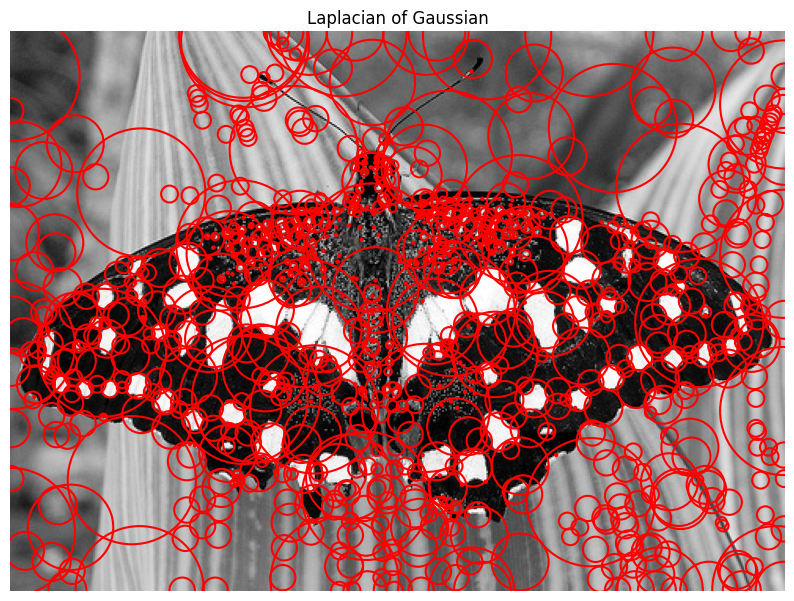

In [ ]:
from scipy.ndimage import maximum_filter

# Aplica un filtro de máximo local tridimensional a log_response
# Se obtiene una estructura del mismo tamaño que log_response con valores booleanos
# indicando qué respuestas máximas locales coinciden con el valor propio y supera
# determinado umbral (nosotros hemos establecido en 0.85)
local_maxima = (maximum_filter(log_response, size=(3,3,3), mode='constant', cval=0) == log_response) & (log_response > 0.85)

# Encuentra y almacena las coordenadas de los máximos locales
blobs_log = np.column_stack(np.where(local_maxima))

# Convierte el tipo de datos de los blobs a float32
blobs_log = blobs_log.astype(np.float32)

# Convierte las escalas expresadas en sigma a radio de la circunferencia correspondiente
blobs_log[:,0] = sigma_list[blobs_log[:,0].astype(int)] * math.sqrt(2)

# Imprime el número de blobs detectados
print("Nº de blobs:", np.shape(blobs_log)[0])

# Preparación y visualización de la imagen con los blobs resaltados
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_title('Laplacian of Gaussian')
ax.imshow(img, cmap='gray')

for blob in blobs_log:
    r, y, x = blob
    c = plt.Circle((x, y), r, color='red', linewidth=1.5, fill=False)
    ax.add_patch(c)

ax.set_axis_off()
plt.show()

En la imagen vemos un gran número de blobs. Alrededor de 1000, que es lo que se nos pide. Podemos ver cómo hay un blob correspondiente para cada mancha en las alas, también podemos ver blobs en los espacios entre estas manchas, ya que hemos detectado blobs también en los mínimos de la laplaciana. También se detectan blobs en los detalles de la flora en el fondo.

Pero todavía falta un requisito solicitado en la práctica: eliminar los blobs cuyo perímetro se salga de la imagen, ya que estos han usado información inventada (padding de ceros) para determinar estos.

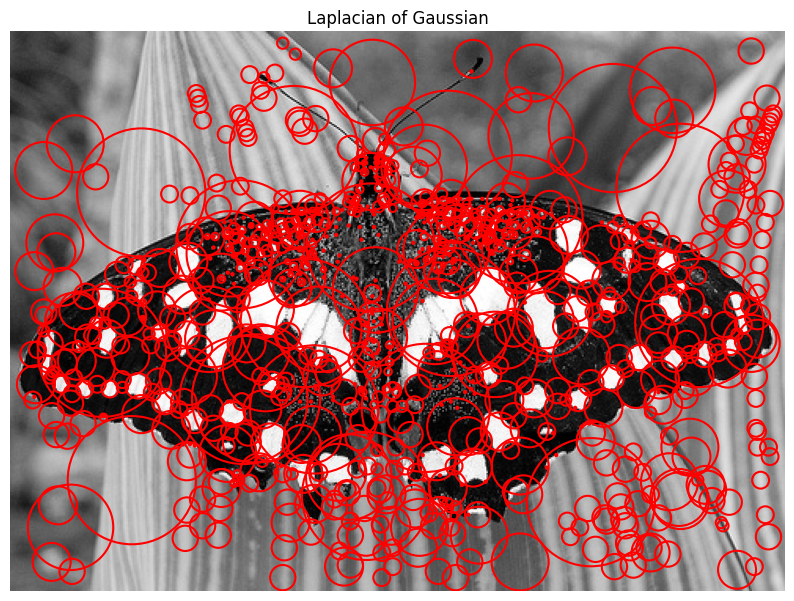

In [ ]:
# Calcula las coordenadas de las esquinas izquierda (xL, yL) y derecha (xR, yR) de cada blob
xA = blobs_log[:, 1] - blobs_log[:, 0]
xB = blobs_log[:, 1] + blobs_log[:, 0]
yL = blobs_log[:, 2] - blobs_log[:, 0]
yR = blobs_log[:, 2] + blobs_log[:, 0]

# Identifica los blobs que se salen de los límites de la imagen
se_sale = (xA < 0) | (xB > num_filas) | (yL < 0) | (yR > num_columnas)

# Filtra los blobs que están completamente dentro de los límites de la imagen
blobs_log = blobs_log[~se_sale]

# Preparación y visualización de la imagen con los blobs válidos resaltados
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_title('Laplacian of Gaussian')
ax.imshow(img, cmap='gray')

for blob in blobs_log:
    r, y, x = blob
    c = plt.Circle((x, y), r, color='red', linewidth=1.5, fill=False)
    ax.add_patch(c)

ax.set_axis_off()
plt.show()

Aquí tenemos el resultado de antes, con los blobs que se salen de la imagen eliminados.

A continuación, crearé una función que reúna todos los procesos realizados para detectar y resaltas los blobs de una imagen mediante el detector multiescala de blobs basado en la Laplaciana de la Gaussiana.

Me he inspirado en el diseño de la función `blob_log` de la biblioteca `skimage` para la determinación de la lista de valores sigma para el filtro laplaciano a partir de los parámetros `min_sigma`, `max_sigma`, `num_sigma` y `log_scale`. Además, he añadido el parámetros `optimum`, que permite controlar la forma en que se calcula la respuesta del filtro laplaciano:
- $+1$: Se detectarán los blobs en los máximos de la aplicación del filtro laplaciana.
- $\ \ 0\ $: Se detectarán los blobs en los máximos y mínimos de la aplicación del filtro laplaciano.
- $-1$: Se detectarán los blobs en los mínimos de la aplicación del filtro laplaciano.


In [ ]:
from scipy.ndimage import maximum_filter

def detect_blobs(img, min_sigma=0.5, max_sigma=28.83251953, num_sigma=11,
                 log_scale=True, threshold=0.85, optimum=0):

    # Paso 1: Convierte los datos de la imagen a tipo float32 y normaliza los valores entre 0 y 1
    img = np.float32(img)
    img = img / img.max()

    # Paso 2: Obtiene el número de filas y columnas
    num_filas, num_columnas = img.shape

    # Paso 3: Definición de una lista de valores sigma para el filtro Laplaciano de la gaussiana (LoG)
    if log_scale:
        start = np.log10(min_sigma)
        stop = np.log10(max_sigma)
        sigma_list = np.logspace(start, stop, num_sigma)
    else:
        sigma_list = np.linspace(min_sigma, max_sigma, num_sigma)

    print("Sigma values used: ", sigma_list)

    # Paso 4: Cálculo de la respuesta LoG correspondientes a cada valor de sigma
    log_response = np.empty((len(sigma_list), num_filas, num_columnas), dtype=np.float32)
    for i, s in enumerate(sigma_list):
      if optimum==1:
        log_response[i, ...] = LoG(img,s)
      elif optimum==0:
        log_response[i, ...] = np.abs(LoG(img,s))
      elif optimum==-1:
        log_response[i, ...] = -LoG(img,s)

    # Paso 5: Aplica un filtro de máximo local tridimensional a log_response
    local_maxima = (maximum_filter(log_response, size=(3, 3, 3), mode='constant', cval=0) == log_response) & (log_response > threshold)

    # Paso 6: Encuentra y almacena las coordenadas de los máximos locales
    blobs_log = np.column_stack(np.where(local_maxima))

    # Paso 7: Convierte el tipo de datos de los blobs a float32
    blobs_log = blobs_log.astype(np.float32)

    # Paso 8: Convierte las escalas expresadas en sigma a radio de la circunferencia correspondiente
    blobs_log[:, 0] = sigma_list[blobs_log[:, 0].astype(int)] * math.sqrt(2)

    # Paso 9: Elimina los blobs que se salen de los límites de la imagen
    xA = blobs_log[:, 1] - blobs_log[:, 0]
    xB = blobs_log[:, 1] + blobs_log[:, 0]
    yL = blobs_log[:, 2] - blobs_log[:, 0]
    yR = blobs_log[:, 2] + blobs_log[:, 0]
    se_sale = (xA < 0) | (xB > num_filas) | (yL < 0) | (yR > num_columnas)
    blobs_log = blobs_log[~se_sale]

    return blobs_log

Por ejemplo, si queremos detectar los blobs solo en los máximos de la aplicación de la Laplaciana:

Sigma values used:  [ 0.5         1.51724138  2.53448276  3.55172414  4.56896552  5.5862069
  6.60344828  7.62068966  8.63793103  9.65517241 10.67241379 11.68965517
 12.70689655 13.72413793 14.74137931 15.75862069 16.77586207 17.79310345
 18.81034483 19.82758621 20.84482759 21.86206897 22.87931034 23.89655172
 24.9137931  25.93103448 26.94827586 27.96551724 28.98275862 30.        ]
Number of blobs: 1003


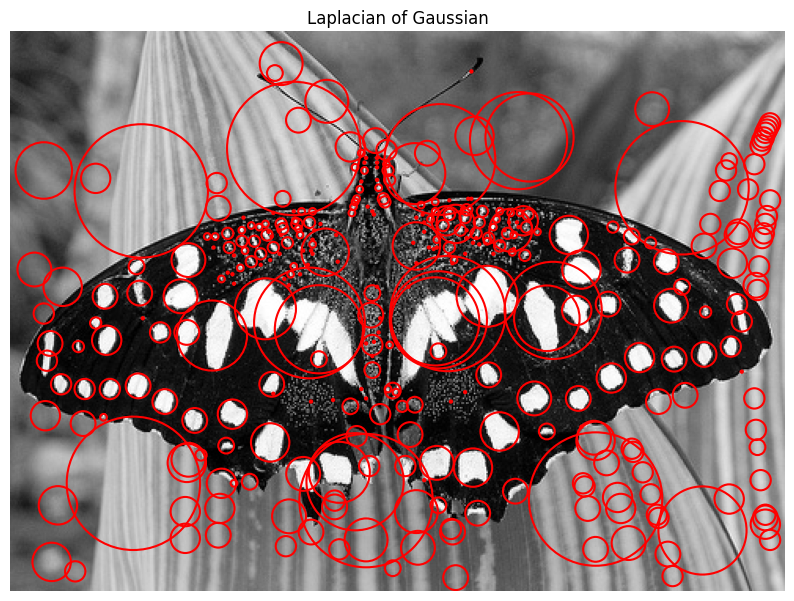

In [ ]:
im_butterfly = readIm(get_image('butterfly.jpg'),0)

blobs_log_butterfly = detect_blobs(im_butterfly, min_sigma=0.5, max_sigma=30, num_sigma=30,
                                   log_scale=False, threshold=0.98, optimum=1)

# Imprime el número de blobs detectados
print("Number of blobs:", np.shape(blobs_log)[0])

# Preparación y visualización de la imagen con los blobs resaltados
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_title('Laplacian of Gaussian')
ax.imshow(im_butterfly, cmap='gray')

for blob in blobs_log_butterfly:
    r, y, x = blob
    c = plt.Circle((x, y), r, color='red', linewidth=1.5, fill=False)
    ax.add_patch(c)

ax.set_axis_off()
plt.show()

A continuación, tenemos otro ejemplo de aplicación del detector, con una imagen de monedas, que tienen la misma forma circular que los filtros laplacianos, lo que permite señalar claramente el perímetro de las monedas.

Sigma values used:  [ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18.
 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30.]
Number of blobs: 1003


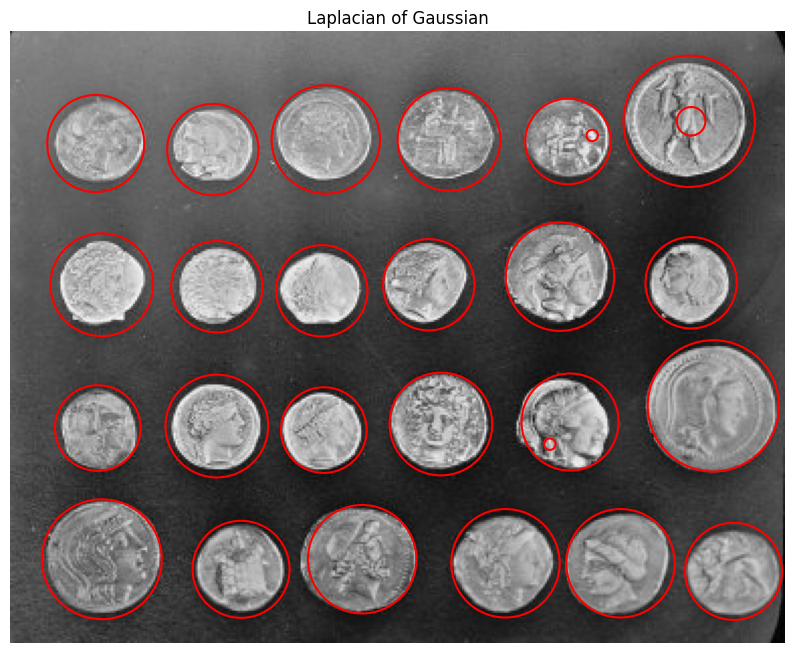

In [ ]:
from skimage import data

im_coins = data.coins()

blobs_log_coins = detect_blobs(im_coins, min_sigma=1, max_sigma=30, num_sigma=30,
                               log_scale=False, threshold=0.98, optimum=1)

# Imprime el número de blobs detectados
print("Number of blobs:", np.shape(blobs_log)[0])

# Preparación y visualización de la imagen con los blobs resaltados
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_title('Laplacian of Gaussian')
ax.imshow(im_coins, cmap='gray')

for blob in blobs_log_coins:
    r, y, x = blob
    c = plt.Circle((x, y), r, color='red', linewidth=1.5, fill=False)
    ax.add_patch(c)

ax.set_axis_off()
plt.show()

# <font color=#80BEF1>**Exercise 2:** Harris Corner Detector (3 points)

<font color=#80BEF1>Write the Python code necessary to implement the detection of the stronger 100-150 Harris points in an image. The steps to implement the Harris corner detector are the following: \


> <font color=#80BEF1>a) Set the derivative ($\sigma_D$) and integration scales ($\sigma_I$) to 1.5 and 2.25, respectively. Other sigma values can also be employed if the student considers that it improves performance.



> <font color=#80BEF1>b) Compute the image derivatives.

> <font color=#80BEF1>c) Compute the three terms of the second moment matrix ($SMM$) at each pixel. To do it, apply convolution with a Gaussian mask with $\sigma_I$.

> <font color=#80BEF1>d) Compute the Harris value at each pixel of the image (discard pixels/points close to the edges).

> <font color=#80BEF1>e) Apply Non-Maxima Suppression by using the function `corner_peaks()` (https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.corner_peaks) from the module `skimage.features`. The student must select a suitable `min_distance` (`minimal allowed distance separating peaks`), and a suitable response threshold in the Harris Map to just keep the number of keypoints we need (100-150). The output will be a list of $(x,y)$ coordinates. Extract the values in these coordinates and create a list of vectors $(x,y,value)$.

> <font color=#80BEF1>f) Compute the main orientation for each point. This is done by smoothing both derivative images with a sufficiently large sigma ($\sigma=3$) and computing the orientation of the gradient at those points.

> <font color=#80BEF1>d) Create a list of KeyPoints using the selected points. A KeyPoint is a vector including $(x,y,scale,orientation)$. A KeyPoint is an OpenCV's structure (`cv2.KeyPoint`), associated to each detected region,  necessary to call OpenCV feature extractor algorithms.

> <font color=#80BEF1>e) Draw the keypoints on the image using the function `drawKeyPoints()` (https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920), and flags `cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.


El **detector de esquinas de Harris** es un operador de detección de esquinas que se usa comúnmente en algoritmos de visión por computadora para extraer esquinas e inferir características de una imagen. Para ello se basa en la intuición de que las esquinas son regiones de una imagen donde ocurren variaciones significativas en la intensidad en todas las direcciones, es decir, las esquinas son puntos donde la función de intensidad cambia tanto en la dirección horizontal como en la vertical. Esta propiedad se puede expresar matemáticamente mediante la derivada de la intensidad de la imagen.

El algoritmo de Harris utiliza la matriz de covarianza de las derivadas parciales de la intensidad para evaluar la respuesta de esquina en cada píxel de la imagen. La matriz de covarianza se define como:

$$
H= \begin{bmatrix}
I_x^2 & I_x I_y \\
I_x I_y & I_y^2
\end{bmatrix}
\\
\text{donde}
\\I_x \text{ y } I_y \text{ son las derivadas parciales de la intensidad respecto a las direcciones } x \text{ e } y \text{, respectivamente.}
$$

Luego, el operador de esquinas de Harris calcula un valor de respuesta para cada píxel, que se define como:

$$
R = \frac{det(M)}{trace(M)+\epsilon}
$$

Este es el valor de respuesta propuesta por Noble J.A. (1998).

Un valor alto de $R$ en un pixel indica que existe una gran variabilidad en la intensidad alrededor de este y, por tanto, se considera una esquina. El problema de este algoritmo, es que pueden considerarse numeros píxeles agrupados como esquinas. Para esto se realiza la **supresión de no máximos** que implica la revisión de los valores de respuesta de esquina en cada píxel y la retención únicamente de aquellos que representan los máximos locales en comparación con sus vecinos inmediatos. Cabe decir que existe un parámetro `min_distance`, que se refiere a la distancia mínima permitida entre las esquinas encontradas. Este proceso ayuda a eliminar duplicados y a centrarse en las esquinas más prominentes, mejorando así la precisión y confiabilidad del detector de esquinas de Harris.

De estos keypoints, se calculará la orientación. Esta proporciona información sobre la dirección predominante de cambio en la intensidad de los píxeles en su vecindario. Finalmente, creamos un objeto `keypoint`, de la biblioteca OpenCV, con las coordenadas, el tamaño que deseamos para el radio del círculo que señalará el keypoint y la orientación del pixel.

Para realizar estos procesos, crearemos las siguientes funciones:

In [ ]:
from skimage.feature import corner_peaks

def derivatives(im, sigmaD=1.5):
    """
    Calcula las derivadas parciales de la imagen en las direcciones x e y.

    Parámetros:
    - im: Imagen de entrada.
    - sigmaD: Parámetro sigma para el kernel derivativo.

    Retorna:
    - dx: Derivada parcial en x.
    - dy: Derivada parcial en y.
    """

    dx = my2DConv(im,sigmaD,[1,0])
    dy = my2DConv(im,sigmaD,[0,1])
    return dx,dy


def HarrisMap(dx,dy, sigmaI=2.25, eps=1e-6):
    """
    Calcula el mapa de esquinas de Harris.

    Parámetros:
    - dx: Derivada parcial en x.
    - dy: Derivada parcial en y.
    - sigmaI: Parámetro sigma para el suavizado de la imagen.
    - eps: Término pequeño para evitar divisiones por cero.

    Retorna:
    - HMap: Mapa de esquinas de Harris.
    """

    # Cálculo de los tres términos de la matriz H (Second Moment Matrix, SMM)
    a = my2DConv(dx*dx,sigmaI,[0,0])
    b = my2DConv(dx*dy,sigmaI,[0,0])
    c = my2DConv(dy*dy,sigmaI,[0,0])

    # Cálculo del determinante y la traza de la matriz H
    detH = a * c - b * b
    traceH = a + c

    # Cálculo de la respuesta (Noble's corner measure)
    HMap = detH / (traceH + eps)

    return HMap


def NonMaximaSuppression(harrisMap, min_distance, threshold):
    """
    Realiza la supresión de no máximos en el mapa de esquinas de Harris.

    Parámetros:
    - harrisMap: Mapa de esquinas de Harris.
    - min_distance: Distancia mínima entre dos esquinas.
    - threshold: Umbral para la respuesta de esquina.

    Retorna:
    - coords: Coordenadas de las esquinas.
    - values: Valores de respuesta en las coordenadas correspondientes.
    """

    coords = corner_peaks(harrisMap, min_distance, threshold)
    values = harrisMap[coords[:, 0], coords[:, 1]]
    return coords, values


def orientation(im, sigmaO=3):
    """
    Calcula el mapa de orientación de una imagen.

    Parámetros:
    - im: Imagen de entrada.
    - sigmaO: Parámetro sigma para el cálculo de derivadas.

    Retorna:
    - theta: Mapa de orientación en grados.
    """

    dx = my2DConv(im,sigmaO,[1,0])
    dy = my2DConv(im,sigmaO,[0,1])
    theta = np.arctan2(dx, dy) * 180 / math.pi
    return theta


def keyPoints(coords,theta,size=10):
    """
    Crea una lista de KeyPoints a partir de coordenadas y orientaciones.

    Parámetros:
    - coords: Coordenadas de puntos clave.
    - theta: Mapa de orientación asociado a la imagen.
    - size: Tamaño de los puntos clave.

    Retorna:
    - keyPoints: Lista de objetos KeyPoint.
    """
    keyPoints=[]

    for i in range(len(coords)):
        y, x = coords[i,0], coords[i,1]
        angle = theta[y,x]
        keyPoints.append(cv2.KeyPoint(x=x.astype(float), y=y.astype(float), size=size, angle=angle))

    return keyPoints

Finalmente, creamos una función `harris_detector()`, para detectar los keypoints en una imagen, usando las funciones definidas anteriormente, y devolverlos.

In [ ]:
def harris_detector(im, threshold = 0.1, min_distance = 1, keyPoints_size = 10,
                    display_steps = False):
    """
    Detecta esquinas utilizando el detector de Harris.

    Parámetros:
    - image: Imagen de entrada.
    - threshold: Umbral para la respuesta de esquina.
    - min_distance: Distancia mínima entre dos esquinas.
    - key_points_size: Tamaño de los puntos clave.
    - display_steps: Indica si se deben mostrar visualizaciones intermedias.

    Retorna:
    - key_points_list: Lista de objetos KeyPoint.
    """

    im = np.float32(im) / im.max()

    dx,dy = derivatives(im)

    if display_steps:
        displayMI_ES([dx,dy], "Derivatives", 2)

    HMap = HarrisMap(dx,dy)

    if display_steps:
        displayIm(HMap, "Harris Map", 2)

    corner_coords, corner_values = NonMaximaSuppression(HMap, min_distance, threshold)

    orientation_map = orientation(im)

    key_points_list = keyPoints(corner_coords, orientation_map, keyPoints_size)

    return key_points_list


def getImageKeypoints(im, keypoints):

    image = np.copy(im)

    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        size = int(kp.size)
        cv2.circle(image, center=(x,y), radius=size, color=(255,0,0), thickness=-1)

    return image

Vamos a probar a detectar las esquinas en una imagen de un tablero de ajedrez:

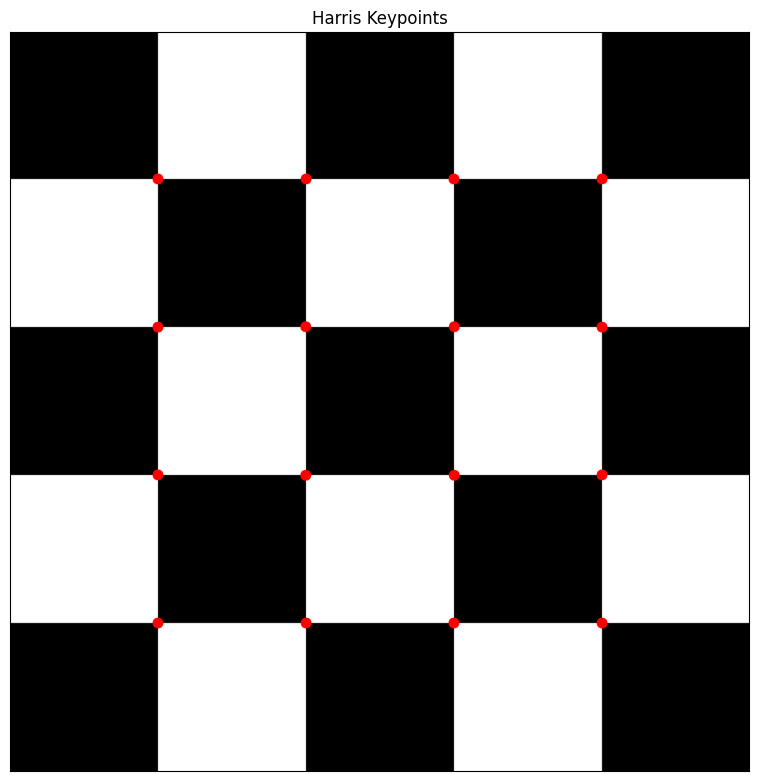

In [ ]:
im_board_rgb = readIm(get_image('Checkerboard.png'),1)

im_board_gray = cv2.cvtColor(im_board_rgb, cv2.COLOR_RGB2GRAY)

keypoints = harris_detector(im_board_gray, threshold=0.05, min_distance=10,
                            keyPoints_size=15, display_steps=False)

im_board_keypoints = getImageKeypoints(im_board_rgb, keypoints)

displayIm(im_board_keypoints, "Harris Keypoints")

Vemos que se han detectado fácilmente las esquinas en esta imagen

Nº de keypoints: 104


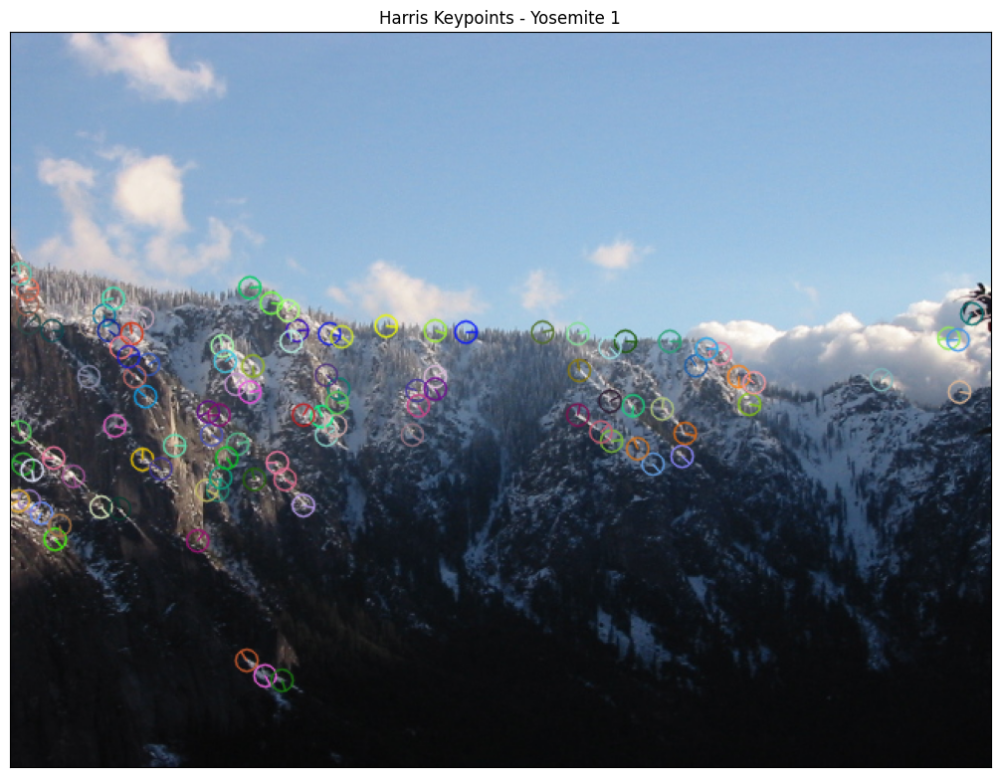

In [ ]:
im_ysmt1_rgb = readIm(get_image('yosemite7.jpg'),1)

im_ysmt1_gray = cv2.cvtColor(im_ysmt1_rgb, cv2.COLOR_RGB2GRAY)

radio = np.shape(im_ysmt1_gray)[0] * 0.03

kps_ysmt1 = harris_detector(im_ysmt1_gray, threshold=0.0045, min_distance=4,
                            keyPoints_size=radio, display_steps=False)

print("Nº de keypoints:", np.shape(kps_ysmt1)[0])

im_ysmt1_kps = np.copy(im_ysmt1_rgb)

cv2.drawKeypoints(im_ysmt1_rgb, kps_ysmt1, im_ysmt1_kps,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

displayIm(im_ysmt1_kps, "Harris Keypoints - Yosemite 1")

Aquí vemos alrededor de 100 keypoints detectados por Harris. Podemos observar que hay un mayor número de keypoints en las zonas donde hay mayores cambios de intensidad, por los picos de la montaña, y apenas hay en las faldas.

Nº de keypoints: 256


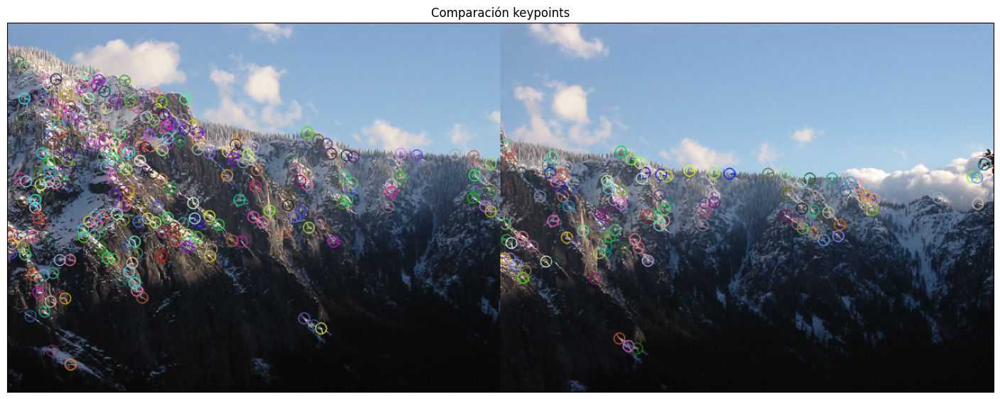

In [ ]:
im_ysmt2_rgb = readIm(get_image('yosemite6.jpg'),1)

im_ysmt2_gray = cv2.cvtColor(im_ysmt2_rgb, cv2.COLOR_RGB2GRAY)

kps_ysmt2 = harris_detector(im_ysmt2_gray, threshold=0.0045, min_distance=4,
                            keyPoints_size=radio, display_steps=False)

print("Nº de keypoints:", np.shape(kps_ysmt2)[0])

im_ysmt2_kps = np.copy(im_ysmt2_rgb)

cv2.drawKeypoints(im_ysmt2_rgb, kps_ysmt2, im_ysmt2_kps,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

displayMI_ES([im_ysmt2_kps, im_ysmt1_kps], "Comparación keypoints",2.8)

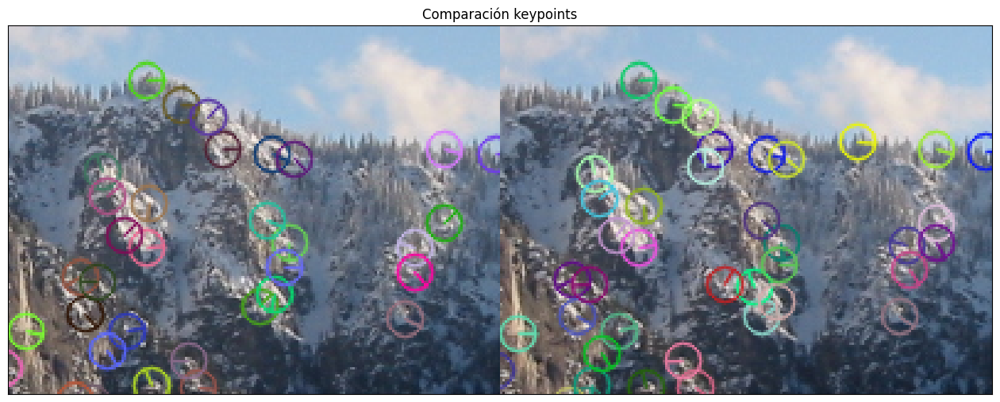

In [ ]:
x, y, width, height = 100, 145, 200, 150
cut_im_ysmt1_kps = im_ysmt1_kps[y:y+height, x:x+width]
x, y, width, height = 333, 120, 200, 150
cut_im_ysmt2_kps = im_ysmt2_kps[y:y+height, x:x+width]

displayMI_ES([cut_im_ysmt2_kps, cut_im_ysmt1_kps], "Comparación keypoints",2.5)

En esta sección de ambas imágenes, podemos observar que la mayoría de los puntos clave se repiten, no solo en una ubicación similar, sino también con una orientación parecida. Esto permite establecer correspondencias entre puntos, como veremos en el siguiente ejercicio.

## Equivariance to translation and rotation

Vamos a realizar un ejercicio adicional para comprobar cómo el detector de esquinas de Harris es equivariante respecto a traslaciones y rotaciones.

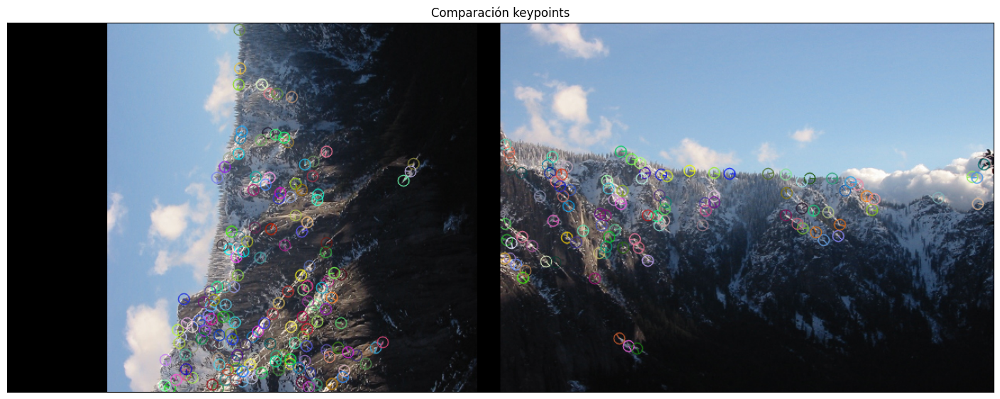

In [ ]:
# Definir la matriz de transformación (traslación y rotación)
rows, cols = im_ysmt2_gray.shape
M = cv2.getRotationMatrix2D((cols/2, rows/2), angle=90, scale=1)
M[:,2] += np.array([50, 30])  # Traslación en x=50, y=30

# Aplicar la transformación a la imagen
im_ysmt2_rgb_m = cv2.warpAffine(im_ysmt2_rgb, M, (cols, rows))

# Aplicar el detector de Harris a la imagen transformada
kps_ysmt2_m = harris_detector(cv2.cvtColor(im_ysmt2_rgb_m, cv2.COLOR_RGB2GRAY),
                              threshold=0.0045, min_distance=4, keyPoints_size=radio,
                              display_steps=False)

im_ysmt2_kps_m = np.copy(im_ysmt2_rgb_m)

cv2.drawKeypoints(im_ysmt2_rgb_m, kps_ysmt2_m, im_ysmt2_kps_m,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

displayMI_ES([im_ysmt2_kps_m, im_ysmt1_kps], "Comparación keypoints",2.8)

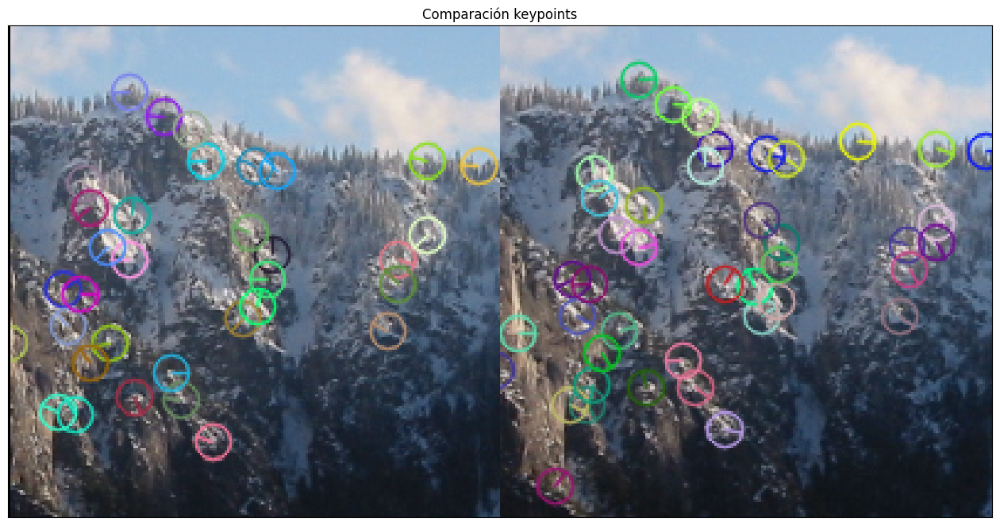

In [ ]:
# Haga el favor de no leer este código feo
x, y, width, height = 100, 145, 200, 200
cut_im_ysmt1_kps = im_ysmt1_kps[y:y+height, x:x+width]
x, y, width, height = 245, 50, 200, 200
cut_im_ysmt2_kps_m = im_ysmt2_kps_m[y:y+height, x:x+width]

M = cv2.getRotationMatrix2D((width/2, height/2), angle=270, scale=1)
cut_im_ysmt2_kps_m = cv2.warpAffine(cut_im_ysmt2_kps_m, M, (width, height))

displayMI_ES([cut_im_ysmt2_kps_m, cut_im_ysmt1_kps], "Comparación keypoints",2.5)

Nos centraremos en esta región de la imagen. Observamos que la mayoría de keypoints permanecen, si bien muestran el sentido opuesto en la orientación.

## Not equivariance to scaling

En cambio, Harris no es equivariante respecto a escalados, como veremos ahora.

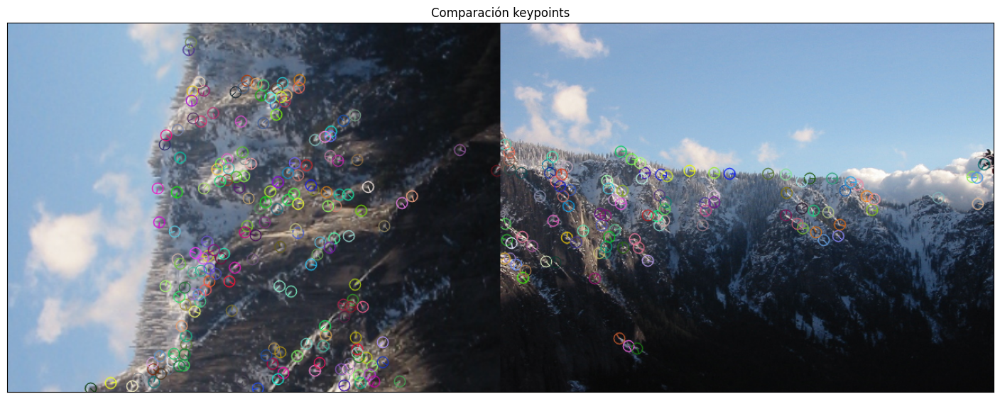

In [ ]:
# Definir la matriz de transformación (traslación, escalado y rotación)
rows, cols = im_ysmt2_gray.shape
M = cv2.getRotationMatrix2D((cols/2, rows/2), angle=90, scale=1.85)
M[:,2] += np.array([50, 70])  # Traslación en x=50, y=70

# Aplicar la transformación a la imagen
im_ysmt2_rgb_m2 = cv2.warpAffine(im_ysmt2_rgb, M, (cols, rows))

# Aplicar el detector de Harris a la imagen transformada
kps_ysmt2_m2 = harris_detector(cv2.cvtColor(im_ysmt2_rgb_m2, cv2.COLOR_RGB2GRAY),
                              threshold=0.0045, min_distance=4, keyPoints_size=radio,
                              display_steps=False)

im_ysmt2_kps_m2 = np.copy(im_ysmt2_rgb_m2)

cv2.drawKeypoints(im_ysmt2_rgb_m2, kps_ysmt2_m2, im_ysmt2_kps_m2,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

displayMI_ES([im_ysmt2_kps_m2, im_ysmt1_kps], "Comparación keypoints",2.8)

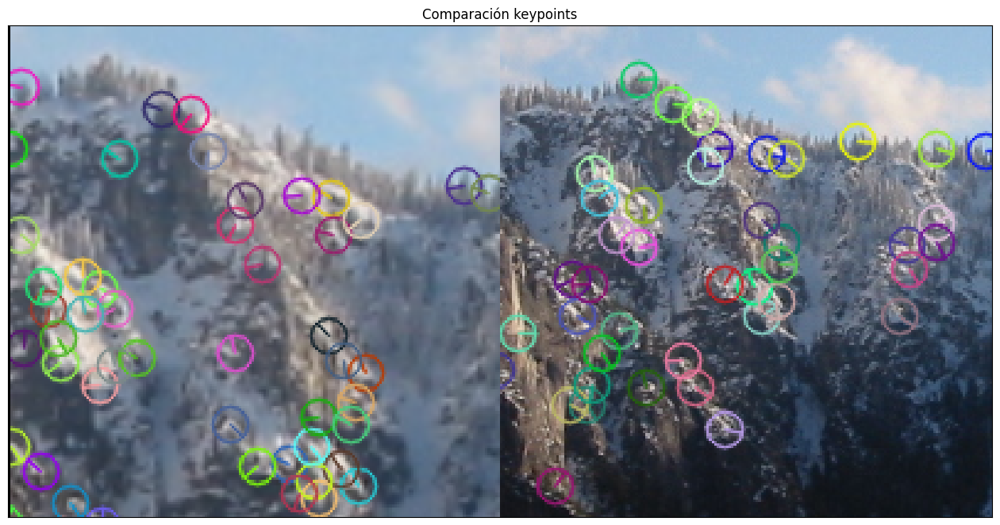

In [ ]:
# Haga el favor de no leer este código feo
x, y, width, height = 100, 145, 200, 200
cut_im_ysmt1_kps = im_ysmt1_kps[y:y+height, x:x+width]
x, y, width, height = 170, 20, 200, 200
cut_im_ysmt2_kps_m2 = im_ysmt2_kps_m2[y:y+height, x:x+width]

M2 = cv2.getRotationMatrix2D((width/2, height/2), angle=270, scale=1)
cut_im_ysmt2_kps_m2 = cv2.warpAffine(cut_im_ysmt2_kps_m2, M2, (width, height))

displayMI_ES([cut_im_ysmt2_kps_m2, cut_im_ysmt1_kps], "Comparación keypoints",2.5)

Podemos apreciar cómo los keypoints cambian completamente, no manteniéndose casi ninguno.

# <font color=#80BEF1>**Exercise 3:** Matching keypoints between images using SIFT and Haralick descriptors (2 points)

<font color=#80BEF1>Write the Python code necessary to compute the matching between points from two images. To do so, you have to apply the SIFT algorithm to both images in order to extract keypoints and descriptors (see https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html). Then, we use the Brute-Force cross-check criterion (`cv2.BFMatcher`) and Lowe's ratio distance criterion (`knnMatch`) to compute the matches and draw the best 100 matches using the function `cv2.drawMatches`.


**SIFT (*Scale-invariant feature transform*)** no solo potencia la detección de esquinas en comparación con el detector de Harris, haciéndolo resistente al escalado, traslaciones y rotaciones, sino que también funciona como descriptor al proporcionar una descripción detallada de los keypoints. Este descriptor se basa en un histograma de orientaciones en el vecindario cercano al keypoint.

In [ ]:
# this function computes KeyPoints and descriptors in an image using SIFT
def siftPoints(im):
    """
    Extrae keypoints y descriptores utilizando el detector de características SIFT.

    Parámetros:
      - im: Imagen de entrada.

    Retorna:
      - kp: Lista de keypoints detectados.
      - ds: Matriz de descriptores asociados a los keypoints.
    """

    sift = cv2.SIFT_create()
    kp,ds = sift.detectAndCompute(im, None)
    return kp,ds


def getKPImage(im,kp):
    """
      Muestra los keypoints de una imagen.

      Parámetros:
        - im: Imagen de entrada.
        - kp: Lista de keypoints a mostrar.
        - title: Título de la ventana de visualización.

      Retorna:
        - img_out: Imagen con keypoints visualizados.
    """

    img_out = np.copy(im)
    cv2.drawKeypoints(im, kp, img_out,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_OVER_OUTIMG+cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return img_out


def getMatchesImage(im1, kp1, im2, kp2, matches, max_matches_to_show=100):
    """
    Muestra los matches entre dos imágenes.

    Parámetros:
      - im1: Primera imagen.
      - kp1: Lista de keypoints de la primera imagen.
      - im2: Segunda imagen.
      - kp2: Lista de keypoints de la segunda imagen.
      - matches: Lista de emparejamientos entre keypoints.
      - max_matches_to_show: Número máximo de emparejamientos a mostrar.
      - title: Título de la ventana de visualización.

    Retorna:
      - im_matching: Imagen con matches visualizados.
    """

    matches_to_show = min(max_matches_to_show, np.shape(matches)[0])

    im_matching = cv2.drawMatches(im1, kp1, im2, kp2,
                                  matches1to2 = matches[:matches_to_show],
                                  outImg = None,
                                  flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    return im_matching


def matching(ds1,ds2,FlagMode='BF'):
    """
      Realiza emparejamientos entre descriptores de dos imágenes.

      Parámetros:
        - ds1: Descriptores de la primera imagen.
        - ds2: Descriptores de la segunda imagen.
        - FlagMode: Modo de emparejamiento, 'BF' para fuerza bruta o 'KNN' para k vecinos más cercanos.

      Retorna:
        - matches: Lista de emparejamientos entre descriptores.

      Nota:
        - Los arrays deben ser numpy y con valores np.float32.
    """

    if FlagMode=='BF':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
        matches = bf.match(ds1,ds2)
        matches = sorted(matches, key = lambda x:x.distance)
        return matches

    elif FlagMode=='KNN':
        bf = cv2.BFMatcher()
        matches = bf.knnMatch(ds1, ds2, k=2)
        good = []
        for m,n in matches:
            if m.distance < 0.2 * n.distance:
                good.append(m)
        return good

    else:
      return print('Error in Matching mode')

Los descriptores de SIFT permiten realizar un emparejamiento entre los keypoints de cada pareja de imágenes consecutivas.



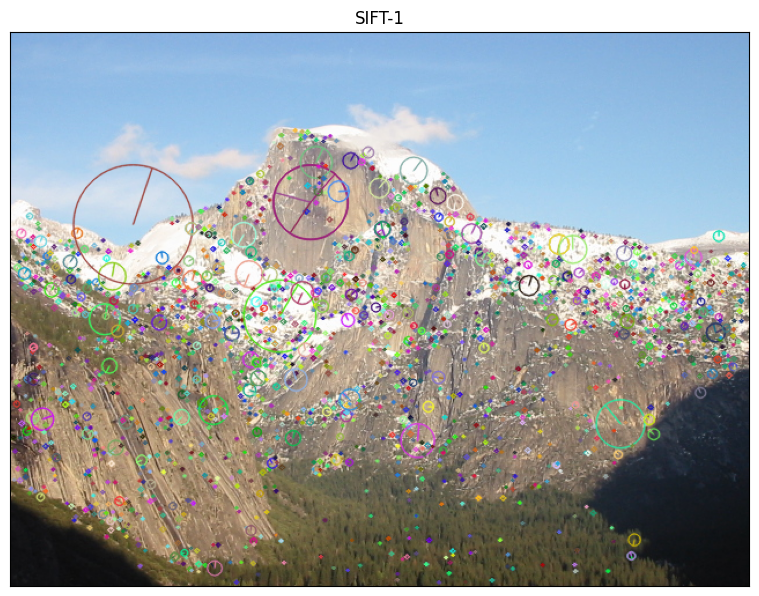

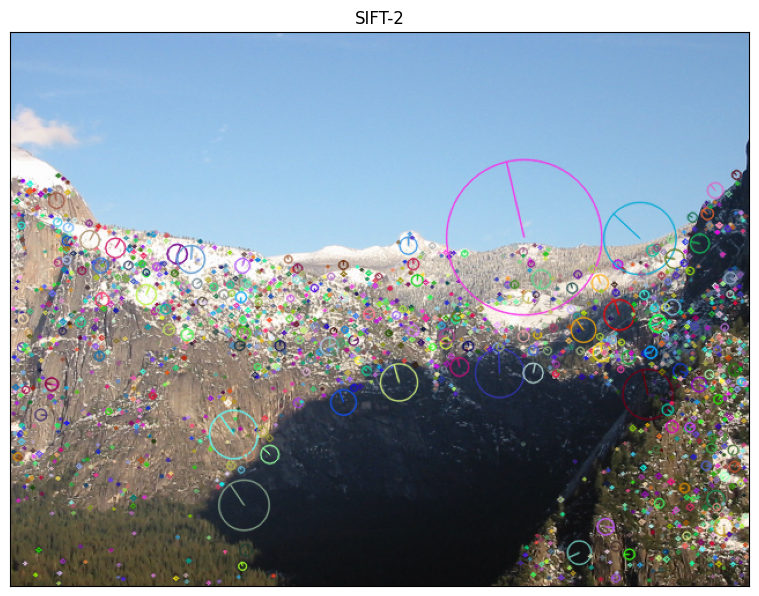

In [ ]:
# Carga las imágenes en RGB y escala de grises
im1=readIm(get_image('yosemite2.jpg'),1) #
img1=cv2.cvtColor(im1,cv2.COLOR_RGB2GRAY)
im2=readIm(get_image('yosemite3.jpg'),1) #
img2=cv2.cvtColor(im2,cv2.COLOR_RGB2GRAY)

# Extrae keypoints y descriptores utilizando SIFT para las imágenes
kp1,ds1 = siftPoints(im1)
kp2,ds2 = siftPoints(im2)

# Obtiene una imagen con los keypoints visualizados para cada imagen
im1_keypoints = getKPImage(im1,kp1)
im2_keypoints = getKPImage(im2,kp2)

# Muestra las imágenes con sus keypoints visualizados
displayIm(im1_keypoints, "SIFT-1", 1.5)
displayIm(im2_keypoints, "SIFT-2", 1.5)

En el enfoque de **fuerza bruta**, cada *keypoint* en la primera imagen se compara con todos los *keypoints* en la segunda, y hace el match con el *keypoint* cuyo descriptor tenga mayor similitud.

Esta medida de similitud se calcula, en nuestro caso, con la distancia euclidiana (`cv2.NORM_L2`) entre los descriptores de los puntos clave.

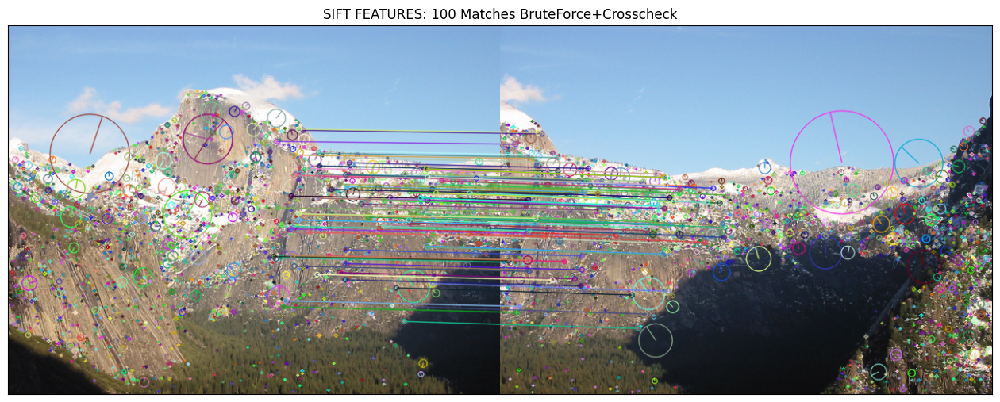

In [ ]:
# Calcula los matches entre descriptores de ambas imágenes mediante fuerza bruta
matchesBF = matching(ds1,ds2,'BF')

# Obtiene una imagen con los matches visualizados
im_matchesBF = getMatchesImage(im1_keypoints,kp1,im2_keypoints,kp2,matchesBF)

# Muestra la imagen con matches visualizados
displayIm(im_matchesBF, "SIFT FEATURES: 100 Matches BruteForce+Crosscheck", 2.5)

El método 2NN (2 vecinos más cercanos), en lugar de comparar cada punto clave con todos los demás, se utilizan los dos vecinos más cercanos para cada punto clave. Se calculan las distancias entre los descriptores y se seleccionan los dos vecinos más cercanos para cada punto clave.

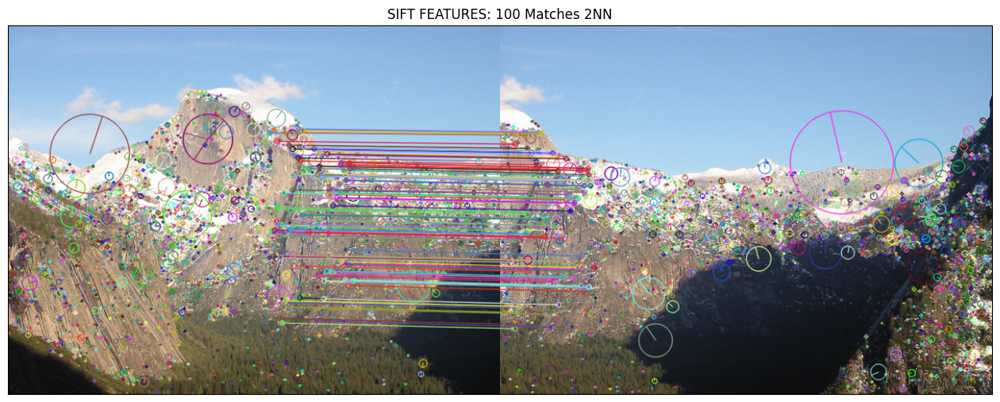

In [ ]:
# Calcula los matches entre descriptores de ambas imágenes mediante KNN
matchesKNN = matching(ds1,ds2,'KNN')

# Obtiene una imagen con los matches visualizados
im_matchesKNN = getMatchesImage(im1_keypoints,kp1,im2_keypoints,kp2,matchesKNN)

# Muestra la imagen con matches visualizados
displayIm(im_matchesKNN, "SIFT FEATURES: 100 Matches 2NN", 2.5)

No apreciamos diferencias significativas entre los resultados de ambos métodos, al menos en nuestro ejemplo.

## Matching using Haralick

<font color=#80BEF1>Now, we have to perform exactly the same operation, but employing Haralick features. To do so, we are going to create a small window ($7\times7$ pixels) centered around the SIFT keypoint detected, and we are going to use `mahotas` library to compute those texture-based descriptors.

Partiremos de los puntos detectados con SIFT, y crearemos los nuevos descriptores Haralick para estos.

In [ ]:
import mahotas
from skimage import color

# Function to compute Haralick features for a given image
def haralickDescriptors(img, keypoints):
    '''
    Calcula descriptores Haralick para una imagen dada en ubicaciones de keypoints específicas.

    Parámetros:
     - img: La imagen de entrada para la cual se calcularán los descriptores Haralick.
     - keypoints: Una lista de objetos cv2.KeyPoint que representan las ubicaciones de los puntos clave en la imagen.

    Devuelve:
     - Una matriz numpy que contiene los descriptores Haralick correspondientes a los keypoints.
    '''
    # Se hace un padding de longitud 3 en los bordes de la imagen con valor 0
    img = np.pad(img, pad_width=3, mode='constant', constant_values=0)

    features = []
    for kp in keypoints:

        # Extract a small window (7x7 pixels) centered around the keypoint
        x, y = int(kp.pt[0])+3, int(kp.pt[1])+3
        window = img[y-3:y+4, x-3:x+4]

        # Compute Haralick features using mahotas
        features.append(
            np.float32(mahotas.features.haralick(window,return_mean_ptp=True)) )

    return np.array(features)


# Se obtienen los descriptores Haralick de ventanas 7x7 alrededor de los puntos de interés
hds1 = haralickDescriptors(img1, kp1)
hds2 = haralickDescriptors(img2, kp2)

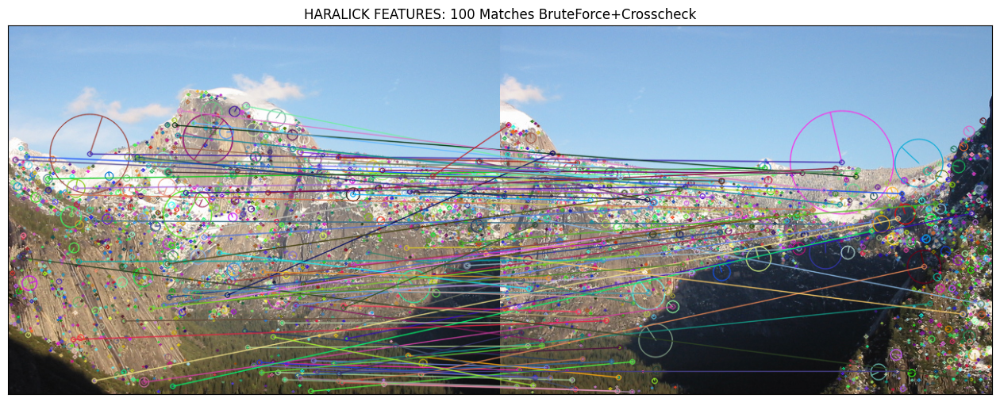

In [ ]:
# Calcula los matches entre descriptores Haralick de ambas imágenes mediante fuerza bruta
matchesHBF = matching(hds1,hds2,'BF')

# Obtiene una imagen con los matches visualizados
im_matchesHBF = getMatchesImage(im1_keypoints,kp1,im2_keypoints,kp2,matchesHBF)

# Muestra la imagen con matches visualizados
displayIm(im_matchesHBF, "HARALICK FEATURES: 100 Matches BruteForce+Crosscheck", 2.5)

Como se observa, los resultados del emparejamiento con descriptores Haralick son algo incoherentes, ya que conecta puntos clave que no presentan similitudes significativas.

<font color=#80BEF1> Which feature descriptor seems to be more suitable for keypoint matching? Why?

El descriptor Haralick está diseñado para describir textones de una textura en una imagen, y no para describir puntos clave distintivos. Es por esto que Haralick falla más que una escopeta de feria.

# <font color=#80BEF1>**Exercise 4:** Image Stitching using Homographies (3 points)

<font color=#80BEF1>Now we are going to compute homographies between images, and use them to build a mosaic/panorama. To calculate the homography between two images, call the function `cv2.findHomography()`, which takes as input the lists of KeyPoints and the matches found between them. Use RANSAC to perform a robust estimation.

Una de las utilidades principales que utilizan los detectores y descriptores de *keypoints* es el *image stitching*. El ***image stitching*** consiste en combinar múltiples imágenes individuales para crear una imagen panorámica más amplia y detallada.

La técnica clave utilizada en el image stitching se basa en el concepto de homografía. Una **homografía** es una transformación afín que describe la relación proyectiva entre dos imágenes, es decir, define cómo una imagen debe ser mapeada respecto a otra cuando se combinan.

Una **transformación afín** es una transformación que implica operaciones como escalado, traslación, rotación y cizallamiento, y se representa mediante una matriz $3\times3$:

$$
\begin{bmatrix}
a_{1,1} & a_{1,2} & a_{1,3} \\
a_{2,1} & a_{2,2} & a_{2,3} \\
0 & 0 & 1
\end{bmatrix}
$$

Estas matrices tienen la propiedad de ser todas invertibles, lo que facilita el cálculo de proyecciones inversas.

Estas homografías se calculan a partir de los emparejamientos (*matches*) entre *keypoints*, determinados conforme a alguno de los métodos vistos en el ejercicio anterior. Estos emparejamientos a menudo contienen correspondencias erróneas. Para abordar este problema, se recurre al método RANSAC (*RANdom SAmple Consensus*), que permite encontrar una homografía que se ajuste a la mayoría de los emparejamientos, ignorando así las correspondencias incorrectas.

A continuación, definimos una función que calcula una homografía a partir de keypoints emparejados y sus matches, a través del método RANSAC. La biblioteca OpenCV nos proporciona la función `find_homography()`, que calcula la homografía entre imágenes, aplicando RANSAC.


In [ ]:
def homography(kp1,kp2,matches, Ransac_Error, MIN_MATCH_COUNT=20):
    """
    Calcula una homografía utilizando los keypoints emparejados y el método RANSAC.

    Parámetros:
      - kp1: Lista de keypoints de la primera imagen.
      - kp2: Lista de keypoints de la segunda imagen.
      - matches: Lista de emparejamientos entre keypoints.
      - Ransac_Error: Umbral de error para el método RANSAC.
      - MIN_MATCH_COUNT: Número mínimo de emparejamientos requeridos para calcular la homografía.

    Retorna:
      - homography: Matriz de homografía 3x3 calculada.
    """


    if len(matches) > MIN_MATCH_COUNT:

        # Extraer los keypoints emparejados
        src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

        # Utilizar RANSAC para estimar la matriz de homografía
        homography,_ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, Ransac_Error)

    else:
        raise ValueError(f"Error - very few matches: {len(matches)}")

    return homography

<font color=#80BEF1>To compose the mosaic we need to provide the following information:

> <font color=#80BEF1>a) Maximum size of the canvas according to the number of images to be stitched and their dimensions.

> <font color=#80BEF1>b) The central image that will give the axes to the mosaic.

> <font color=#80BEF1>c) The order of each image with respect to the central one (i.e., we know the position of each image in the burst of images taken).

> <font color=#80BEF1>d) The homography to copy the central image into the canvas.

<font color=#80BEF1>Now, once all the aforementioned decisions have been made, we need to proceed as follows:
> <font color=#80BEF1>a) Read the images from left to right.

> <font color=#80BEF1>b) Set one central image as the reference to create the panorama. This one will provide the axes to the canvas.

> <font color=#80BEF1>c) Compute the homography between each two consecutive images in your list.

> <font color=#80BEF1>d) Set the canvas and the reference homography.

> <font color=#80BEF1>e) Compute the homography between each image and the canvas.

> <font color=#80BEF1>f) Use the computed homographies to transport the images to the canvas. Use the function `cv2. warpPerspective()`.

> <font color=#80BEF1>g) Remove the black regions from the canvas to improve quality.



Y ahora, crearemos las funciones con los pasos solicitados:

In [ ]:
def computeLocalHomographies(images, method='BF', Ransac_Error=5.0):
    """
    Esta función calcula las homografías entre cada par de imágenes consecutivas.

    Parámetros:
      - images: Imágenes de entrada.
      - method: Método para la determinación de homografías.
      - Ransac_Error: Umbral de error para el método RANSAC.

    Retorna:
      - homographies: Lista de matrices de homografía que transforman una imagen en la siguiente.
    """

    # Extraer keypoints y descriptores para cada imagen
    kp, ds = zip(*(siftPoints(im) for im in images))

    # Calcular homografías entre imágenes consecutivas
    homographies = []

    for i in range( len(kp)-1 ):

      # Realizar el emparejamiento de descriptores
      matches = matching(ds[i], ds[i+1], method)
      # Calcular la homografía usando  RANSAC y agregarla a la lista
      homographies.append( homography(kp[i], kp[i+1], matches, Ransac_Error) )

    return homographies


def mosaicHomographies(homographies, idxc):
    """
    Esta función calcula la homografía de cada imagen respecto a la imagen central.

    Parámetros:
      - homographies: Lista de matrices de homografía.
      - idxc: Índice de la imagen central con respecto a la cual se hacen las homografías.

    Retorna:
      - homographies: Lista de matrices de homografía modificadas.
    """

    num_homographies = len(homographies) + 1

    # Multiplica las homografías en orden descendente
    cumulative_matrix = np.eye(3)
    for i in range(idxc - 1, -1, -1):
        cumulative_matrix = np.matmul(cumulative_matrix, homographies[i])
        homographies[i] = cumulative_matrix

    # Inserta la homografía identidad en la posición idxc
    homographies.insert(idxc, np.eye(3))

    # Multiplica las homografías en orden ascendente (invirtiéndolas)
    cumulative_matrix = np.eye(3)
    for i in range(idxc + 1, num_homographies, 1):
        cumulative_matrix = np.matmul(cumulative_matrix, np.linalg.inv(homographies[i]))
        homographies[i] = cumulative_matrix

    return homographies


def axesHomography(sizeim, sizecanvas):
    """
    Calcula una matriz de homografía que posiciona el centro de la imagen en el centro del lienzo.

    Parámetros:
      - sizeim: Dimensiones (alto, ancho) de la imagen original.
      - sizecanvas: Dimensiones (alto, ancho) del lienzo de destino.

    Retorna:
      - H (numpy.ndarray): Matriz de homografía 3x3 para la translación de la imagen central al canvas.
    """

    H = np.eye(3)
    H[0,2] = sizecanvas[1]//2-sizeim[1]//2
    H[1,2] = sizecanvas[0]//2-sizeim[0]//2
    return H

In [ ]:
def setCanvas(rows,cols,flagColor=1):
    """
    Crea un lienzo con las dimensiones dadas y opcionalmente especifica el formato de color.

    Parámetros:
      - rows: Número de filas del lienzo.
      - cols: Número de columnas del lienzo.
      - flagColor: Indicador para el tipo de lienzo (0 para escala de grises, 1 para RGB).

    Retorna:
      - canvas: Lienzo creado.
    """

    if flagColor == 0:
        # Lienzo en escala de grises
        return np.zeros((rows, cols), np.uint8)
    elif flagColor == 1:
        # Lienzo RGB (3 canales)
        return np.zeros((rows, cols, 3), np.uint8)
    else:
        # Otros casos (puedes manejarlos según sea necesario)
        raise ValueError("El valor de flagColor debe ser 0 (escala de grises) o 1 (RGB).")


def blackOut(img, offset=0):
    """
    Elimina regiones completamente negras alrededor de la región de interés en una imagen.

    Parámetros:
      - img: Imagen de entrada, puede ser en escala de grises o en formato RGB.
      - offset: Píxeles adicionales a excluir alrededor de la región de interés.

    Retorna:
      - img_cropped: Imagen resultante después de eliminar las regiones negras.
    """

    if len(img.shape)==3:
        im =cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
        mask = np.array((im > 0), np.uint8)
        x,y,w,h=cv2.boundingRect(mask)
        return img[y+offset:y+h-offset,x+offset:x+w-offset,:]
    else:
        mask = np.array((img > 0), np.uint8)
        x,y,w,h=cv2.boundingRect(mask)
        return img[y+offset:y+h-offset,x+offset:x+w-offset]

In [ ]:
# this function composes the mosaic
def composeMosaic(images, canvas, H_to_center, idxc, H0, display_steps):
  """
  Compone un mosaico utilizando homografías para proyectar imágenes en un lienzo.

  Parámetros:
    - images: Lista de imágenes a proyectar en el lienzo.
    - canvas: Lienzo en el cual se proyectan las imágenes.
    - H_to_center: Lista de homografías que llevan cada imagen a proyectarse respecto a la imagen central.
    - idxc: Índice de la imagen central en la lista de homografías.
    - H0: Homografía de referencia para proyectar las homografías locales en el lienzo.

  Retorna:
    - mosaic: Mosaico resultante después de proyectar todas las imágenes.

  """

  rows,cols = canvas.shape[:2]
  num_homographies = len(H_to_center)

  # Cálculo de la homografía que lleva cada imagen a proyectarse respecto a la imagen
  # central en el lienzo
  H_to_canvas = np.matmul(H0, H_to_center[:])

  # Bucle ascendente hasta center_index
  for i in range(idxc):
    mosaic = cv2.warpPerspective(images[i], H_to_canvas[i], (cols,rows), dst=canvas,
                                 flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)

    if display_steps: displayIm(canvas,'',2)

  # Bucle descendente desde el final hasta idxc
  for i in range(num_homographies-1, idxc-1, -1):
    mosaic = cv2.warpPerspective(images[i], H_to_canvas[i], (cols,rows), dst=canvas,
                                 flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_TRANSPARENT)

    if display_steps: displayIm(canvas,'',2)

  return mosaic

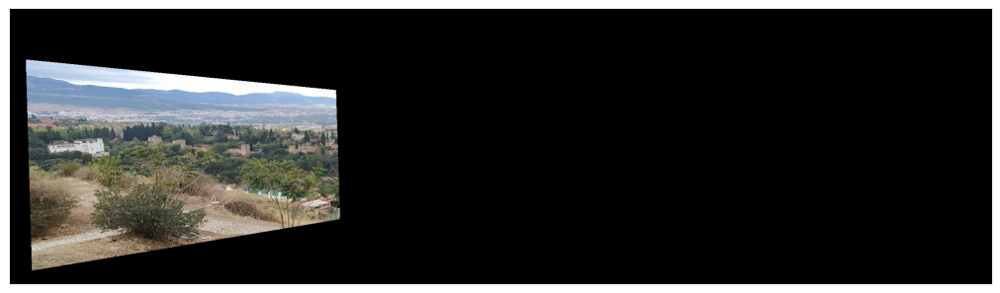

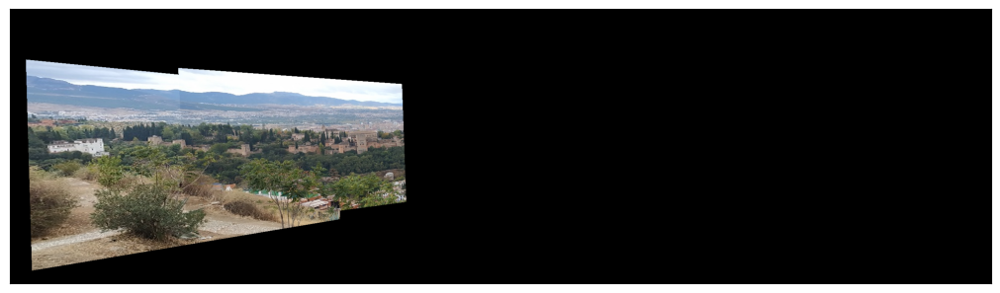

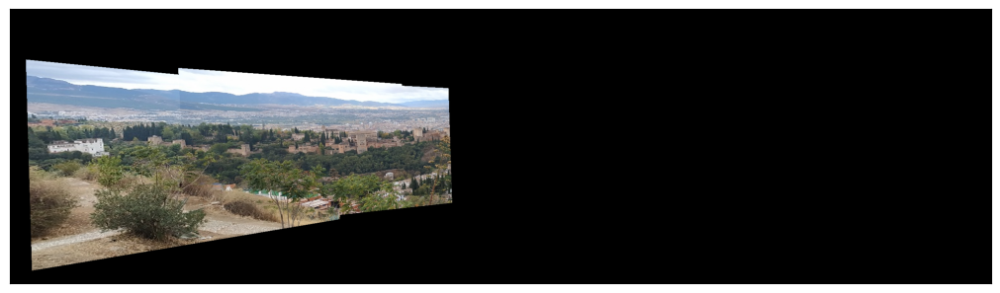

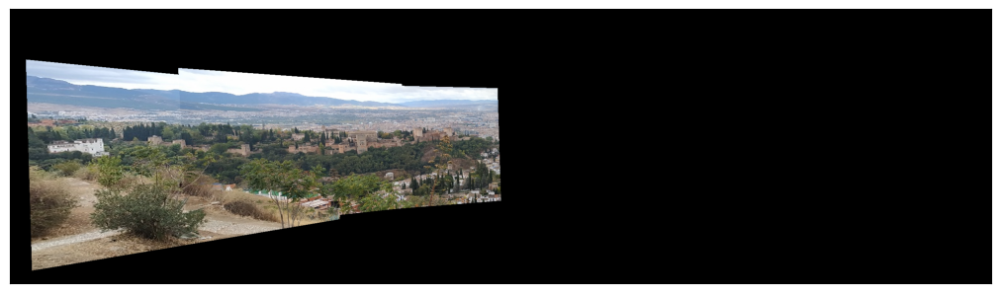

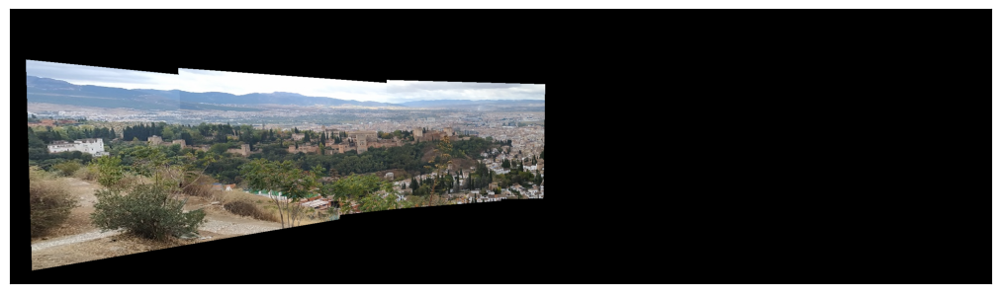

...

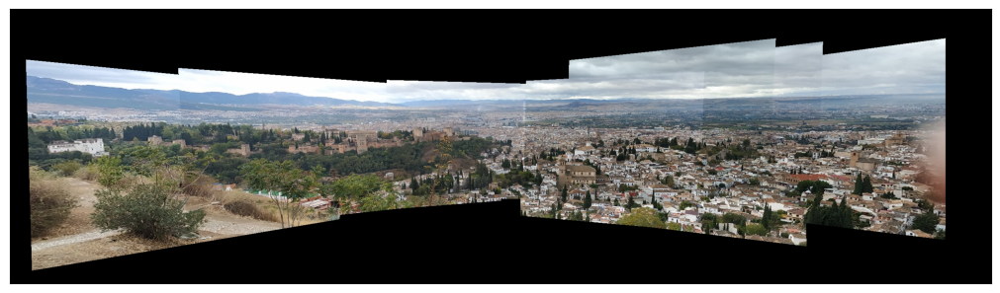

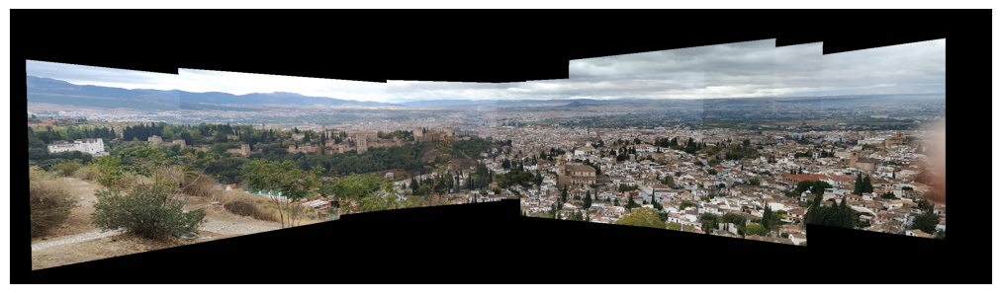

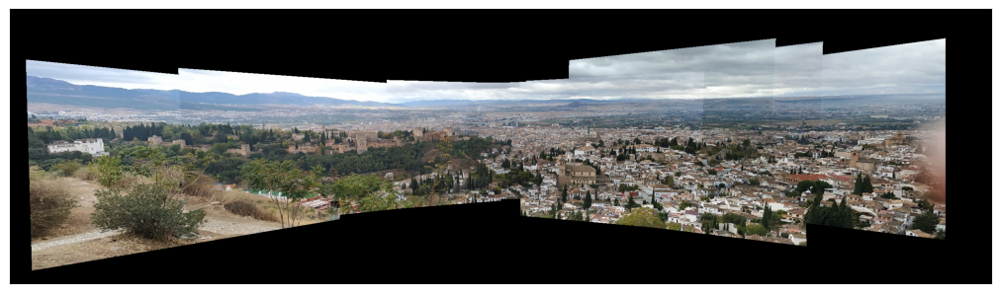

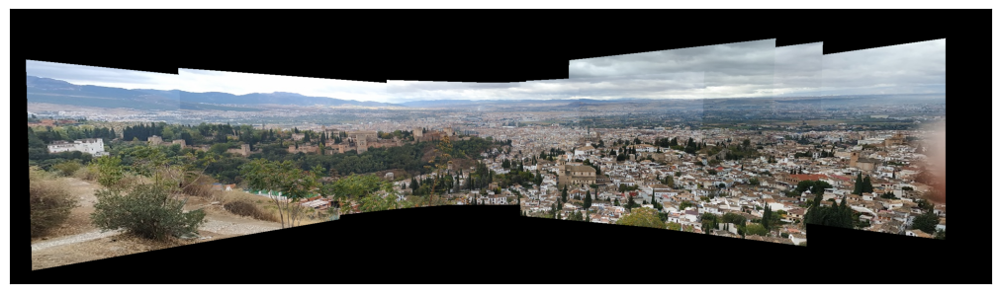

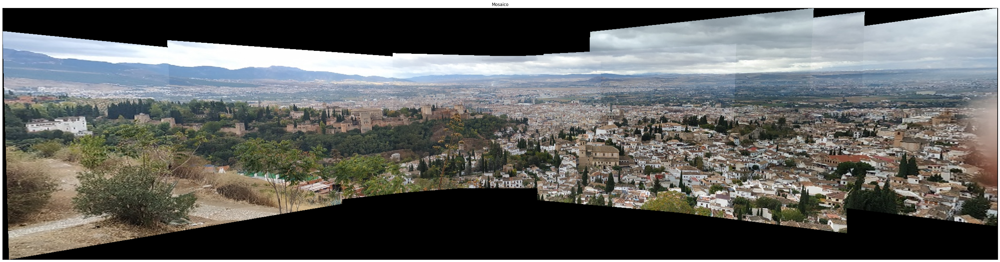

In [ ]:
#Mosaic construction: Left-Right camera motion
images=[]

PREFIX='IMG_20211030_1104'
DIR=''
nameImages=['10_S.jpg','13_S.jpg','15_S.jpg','17_S.jpg','18_S.jpg','20_S.jpg',
            '21_S.jpg', '25_S.jpg','26_S.jpg', '28_S.jpg','31_S.jpg','33_S.jpg',
            '34_S.jpg','36_S.jpg']

# Cargar las imágenes en la lista 'images' (de izquierda a derecha)
for item in nameImages:
  images.append(readIm(get_image(PREFIX+item),flagColor=1))

# Determinación del índice de la imagen central en la lista de imágenes
idx_center = 5

# Calcular homografías locales entre imágenes consecutivas utilizando el método 'BF'
H = computeLocalHomographies(images,'BF')

# Calcular homografía global acumulativa para cada imagen con respecto a la imagen central
H = mosaicHomographies(H, idx_center)

# Crear un lienzo vacío para el mosaico con dimensiones específicas (las dimensiones
# han sido determinadas por prueba y error, tratando de ajustarse al tamaño del
# mosaico resultante)
canvas = setCanvas(700,2500)

# Calcular la homografía que sitúa el centro de la imagen central en el centro del lienzo
H0 = axesHomography(images[idx_center].shape, canvas.shape)

# Componer el mosaico aplicando las homografías a las imágenes en el lienzo
mosaic= composeMosaic(images,canvas,H,idx_center,H0,display_steps=True)

# Mostrar el mosaico después de eliminar regiones completamente negras alrededor
displayIm(blackOut(mosaic),'Mosaico',8)

Como podemos apreciar, el resultado es bastante satisfactorio, proporcionando una imagen sin grandes cortes aparentes, si bien sí se notan cambios de intensidad entre imágenes superpuestas.

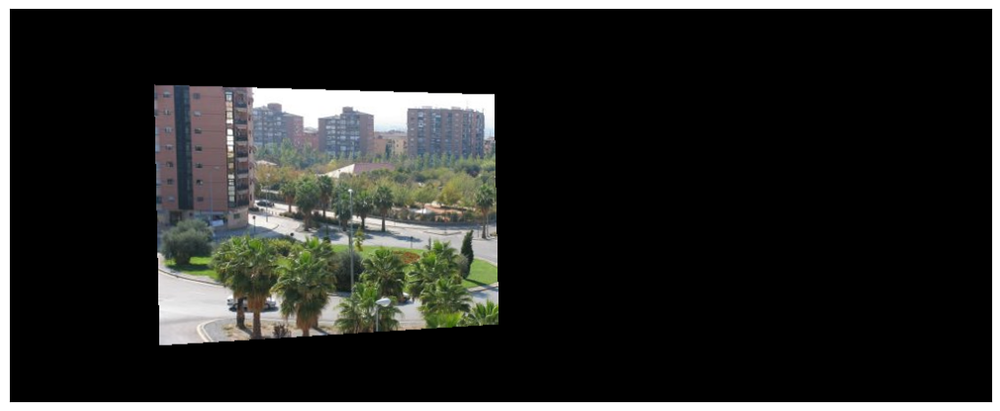

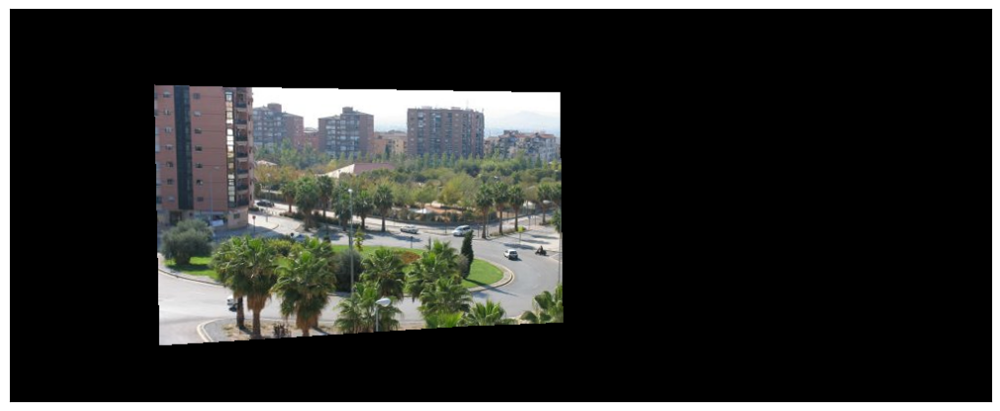

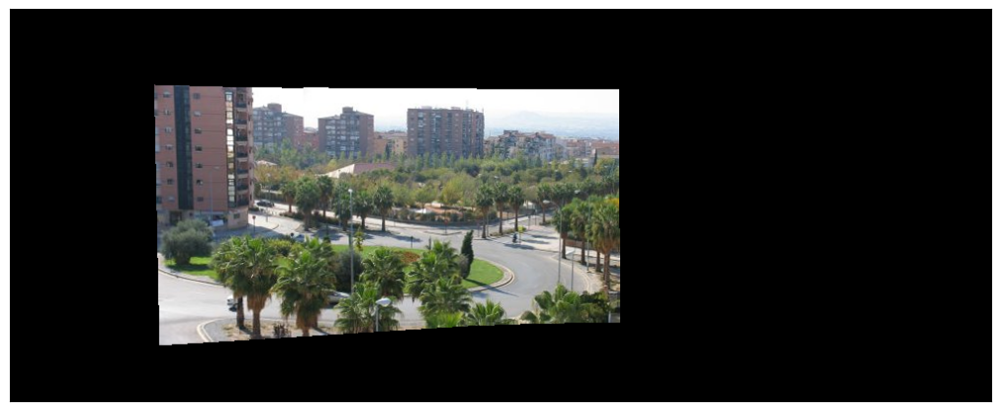

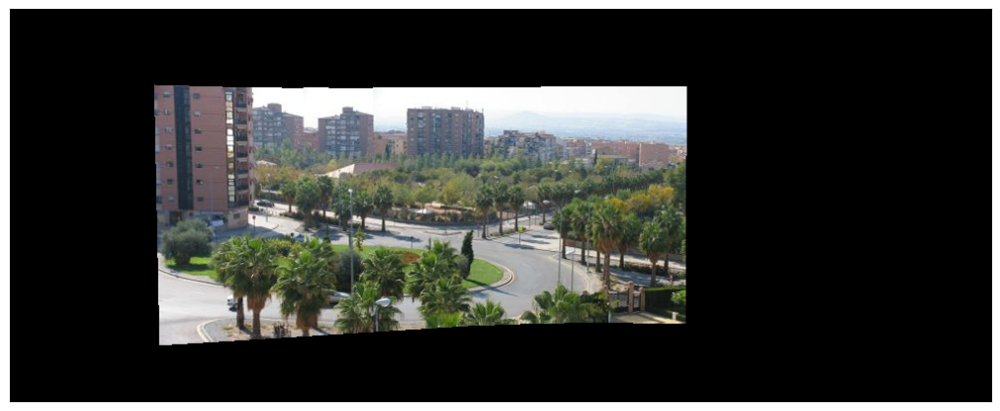

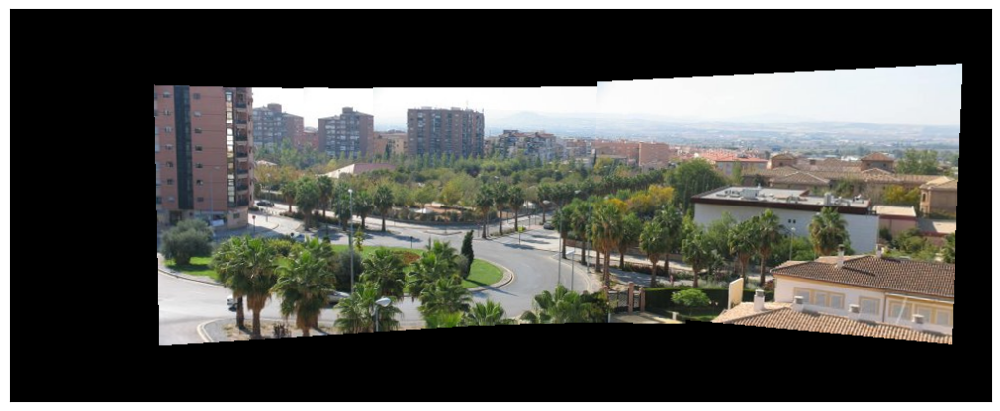

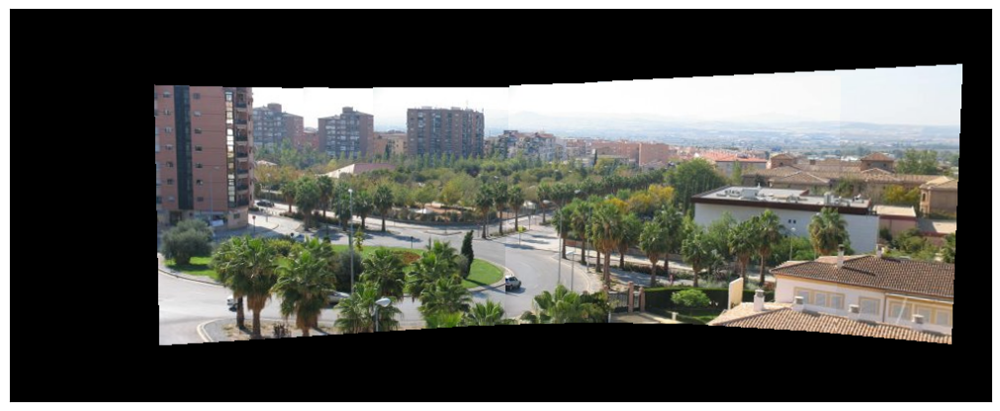

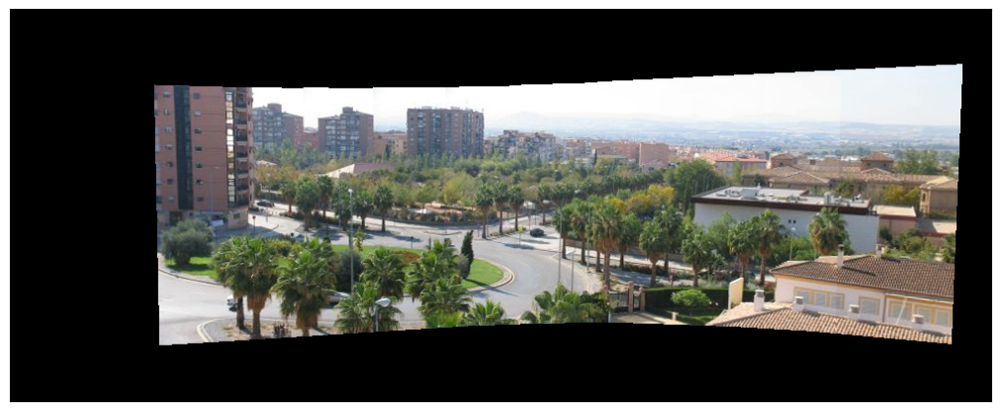

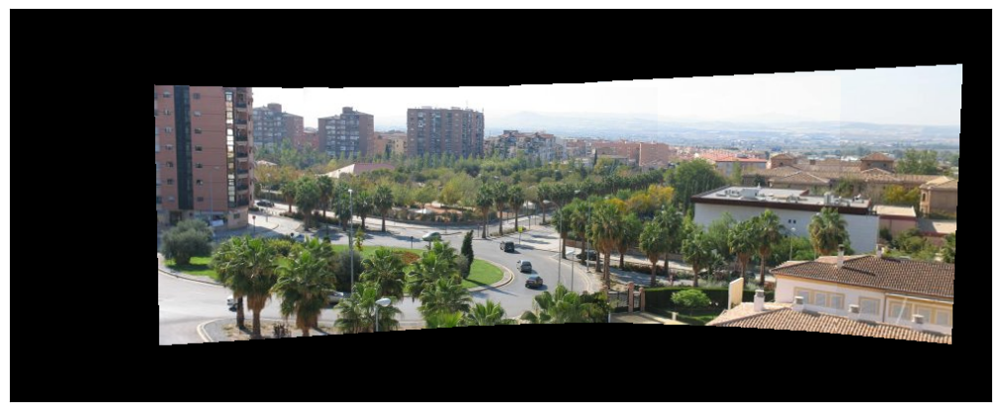

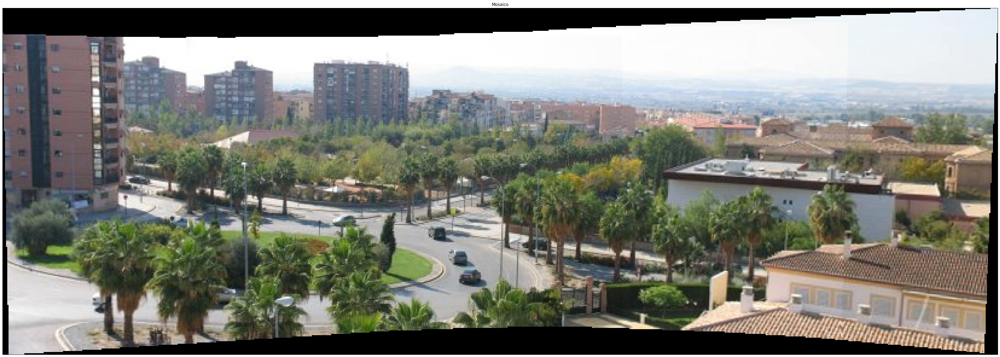

In [ ]:
#Mosaic construction: Left-Right camera motion
images=[]

PREFIX='mosaico'
DIR=''
nameImages=['002.jpg','003.jpg','004.jpg','005.jpg','006.jpg','007.jpg',
            '008.jpg', '009.jpg']

# Cargar las imágenes en la lista 'images' (de izquierda a derecha)
for item in nameImages:
  images.append(readIm(get_image(PREFIX+item),flagColor=1))

# Determinación del índice de la imagen central en la lista de imágenes
idx_center = 4

# Calcular homografías locales entre imágenes consecutivas utilizando el método 'KNN'
H = computeLocalHomographies(images,'KNN')

# Calcular homografía global acumulativa para cada imagen con respecto a la imagen central
H = mosaicHomographies(H, idx_center)

# Crear un lienzo vacío para el mosaico con dimensiones específicas (las dimensiones
# han sido determinadas por prueba y error, tratando de ajustarse al tamaño del
# mosaico resultante)
canvas = setCanvas(400,1000)

# Calcular la homografía que sitúa el centro de la imagen central en el centro del lienzo
H0 = axesHomography(images[idx_center].shape, canvas.shape)

# Componer el mosaico aplicando las homografías a las imágenes en el lienzo
mosaic= composeMosaic(images,canvas,H,idx_center,H0,display_steps=True)

# Mostrar el mosaico después de eliminar regiones completamente negras alrededor
displayIm(blackOut(mosaic),'Mosaico',8)

Cabe decir que elementos móviles como los coches podrían haber sido cortados en las imágenes, si los keypoints emparejados hubiesen pasado justo por ellos.